In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nilearn.plotting import plot_design_matrix
import statsmodels.api as sm
import os
import shutil

## How models were chosen

This is our first time using this set of psychological assessment measures, along with efficiency and VIF, to select the best designs.  `prob_runs_gte2` is the probability of having equal to or larger than 2 conditions in a row and we decided not to choose designs that minimize this measure because it wouldn't work well when there are only 2 conditions as it would favor alternating the two conditions.  `kao_meas` and `run_num_diff_from_avg` both compare pattern occurrences in a given design to what is expected by chance (minimizing this is the goal).  The actual measure is the sum of the absolute differences.  The `prob_next_given_last1` and `prob_next_given_last2` are the max conditional probabilities estimated using the given design's trial order (e.g., estimate prob(current|last) for each condition pair and take the max)  Patrick was curious whether this measure would be better if it instead was a sum of absolute differences.  Both styles if measures have pros and cons.  We did compare and there wasn't much change when `max_diff_prob_next_given_last1`/`max_diff_prob_next_given_last2` were used instead of or in addition to the max conditional probability measures, so we stuck with the original plan and just used `prob_next_given_last1`/`prob_next_given_last2`, the max probability measures.

We also used `scan_length`, the vif's and minimized efficiency.  For each measure they were ranked from best to worst.  Then the top X designs within each measure were selected and the overlap of these designs was checked.  The value of X was increased until the overlap set contained the desired number of designs.

In [2]:
#simulation output data location.  This dataset was generated on Sherlock and copied to my local machine to run this.  
outdir = '/Users/jeanettemumford/Dropbox/Research/Projects/patrick/output_abs_diff_probs/'


def get_events_eff_data(outdir, task):
    events_all = []
    for i in range(1,6):
        events = pd.read_pickle(f'{outdir}/{task}_events_{i}.pkl') 
        events_all.extend(events)

    output_list = []

    for i in range(1,6):
        output_list.append(pd.read_csv(f'{outdir}/{task}_output_{i}.csv'))
    output_all = pd.concat(output_list, ignore_index=True)
    output_all = output_all.loc[:, ~output_all.columns.str.contains('^Unnamed')]
    ranks = {col: np.argsort(output_all[col].to_numpy()) for col in output_all.columns}
    return events_all, output_all, ranks

In [3]:
def draw_histograms(output, overlap_array, variables, n_rows, n_cols, title=None):
    '''
    Plots histogram and location of top model picks
    '''
    line_colors = sns.color_palette("bright", len(overlap_array))
    fig=plt.figure(figsize=(12, 12))
    if title is not None:
        plt.suptitle(title)
    for i, var_name in enumerate(variables):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        ax.hist(output[var_name], 100, color='lightgray')
        if 'vif' in var_name:
            ax.axvline(x=5, color='black', 
                    linewidth=2)
        for color_ind, index in enumerate(overlap_array):
            ax.axvline(x=output[var_name][index], color=line_colors[color_ind], 
                    linewidth=1, label=index)
        ax.set_title(var_name)
        ax.legend(fontsize=7)
    fig.tight_layout()  
    plt.show()

In [4]:
# Where chose design are saved
root = '/Users/jeanettemumford/Dropbox/Research/Projects/patrick/efficiency_rdoc/final_designs'

def save_chosen_events_files(task, output, events, overlap_array, root):
    outdir = f'{root}/{task}'
    if os.path.exists(outdir):
        shutil.rmtree(outdir)
    os.makedirs(outdir)
    for save_index in overlap_array:
        events[save_index].to_csv(f'{outdir}/{task}_events_{save_index}.csv')
    output_save = output.iloc[overlap_array,:]
    output_save.to_csv(f'{outdir}/{task}_model_assessment_values.csv')

In [5]:
def choose_designs(output, ranks, choice, n_des, task_name, psych_meas, make_grid_plot=True):
    if make_grid_plot:
        g = sns.PairGrid(output.loc[:500,:])
        g.map_diag(sns.histplot)
        g.map_offdiag(sns.scatterplot)
        plt.show()

    best_high = [name for name in output.columns if 'eff' in name]
    if choice == 'sum_measure_only':
        best_low = [name for name in output.columns if 'vif' in name] + \
                    psych_meas + \
                    ['sum_abs_diff_prob_next_given_last1',
                   'sum_abs_diff_prob_next_given_last2']
        all_labels_hist = best_high + [name for name in output if 'vif' in name] + \
                    psych_meas + ['prob_next_given_last1', 'prob_next_given_last2', 
                    'sum_abs_diff_prob_next_given_last1',
                    'sum_abs_diff_prob_next_given_last2'] 
    if choice == 'max_measure_only':
        best_low = [name for name in output.columns if 'vif' in name] + \
                    psych_meas + \
                    ['prob_next_given_last1', 'prob_next_given_last2']
        all_labels_hist = best_high + [name for name in output if 'vif' in name] + \
                    psych_meas + ['prob_next_given_last1', 'prob_next_given_last2', 
                    'sum_abs_diff_prob_next_given_last1',
                    'sum_abs_diff_prob_next_given_last2'] 
    if choice == 'both':
        best_low = [name for name in output.columns if 'vif' in name] + \
                    psych_meas + \
                    ['prob_next_given_last1', 'prob_next_given_last2', 
                    'sum_abs_diff_prob_next_given_last1',
                    'sum_abs_diff_prob_next_given_last2']
        all_labels_hist = best_high + [name for name in output if 'vif' in name] + \
                    psych_meas + ['prob_next_given_last1', 'prob_next_given_last2', 
                    'sum_abs_diff_prob_next_given_last1',
                    'sum_abs_diff_prob_next_given_last2'] 
    if choice == 'neither':
        best_low = [name for name in output.columns if 'vif' in name] + \
                    psych_meas
        all_labels_hist = best_high + [name for name in output if 'vif' in name] + \
                    psych_meas  

    len_overlap_set = 0
    top_number = 1000
    add_amount = 5000
    while len_overlap_set < n_des:
        overlap_set = set(np.arange(output.shape[0]))
        for high_label in best_high:
            overlap_set = set.intersection(overlap_set, ranks[high_label][-top_number:])
        for low_label in best_low:
            overlap_set = set.intersection(overlap_set, ranks[low_label][:top_number])
        len_overlap_set = len(overlap_set)
        if len_overlap_set < n_des:
            top_number = top_number + add_amount
        if len_overlap_set > n_des:
            add_amount = int(np.floor(add_amount/2))
            top_number = top_number - add_amount
            len_overlap_set = 0

    nrows_plot = int(np.ceil(len(all_labels_hist)/5))
    draw_histograms(output, overlap_set, all_labels_hist, 5, nrows_plot, title=f'{task_name} using {choice}')
    print(overlap_set)
    return overlap_set

## Flanker and Stroop

In [6]:
events_flanker_stroop, output_flanker_stroop, ranks_flanker_stroop = get_events_eff_data(outdir, 'flanker_stroop')

In [7]:
#check that all simulations ran
print(output_flanker_stroop.shape)

(100000, 16)


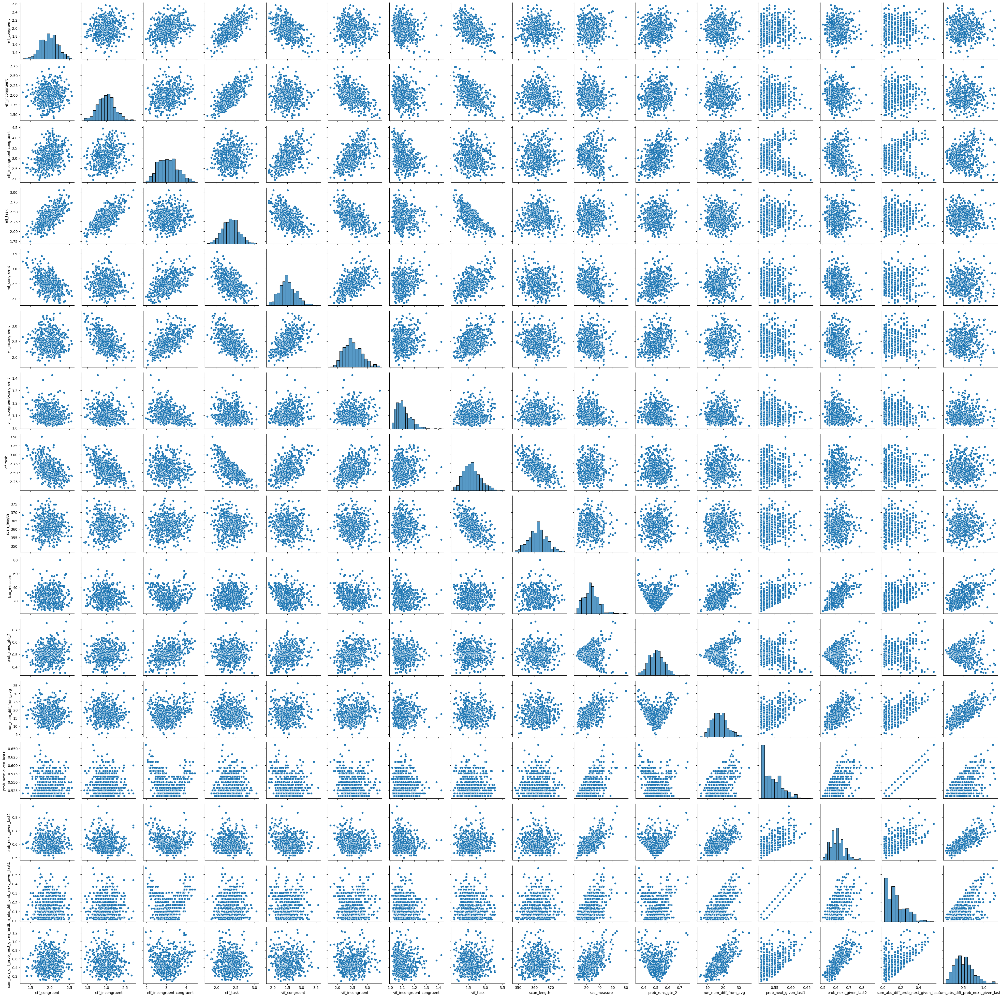

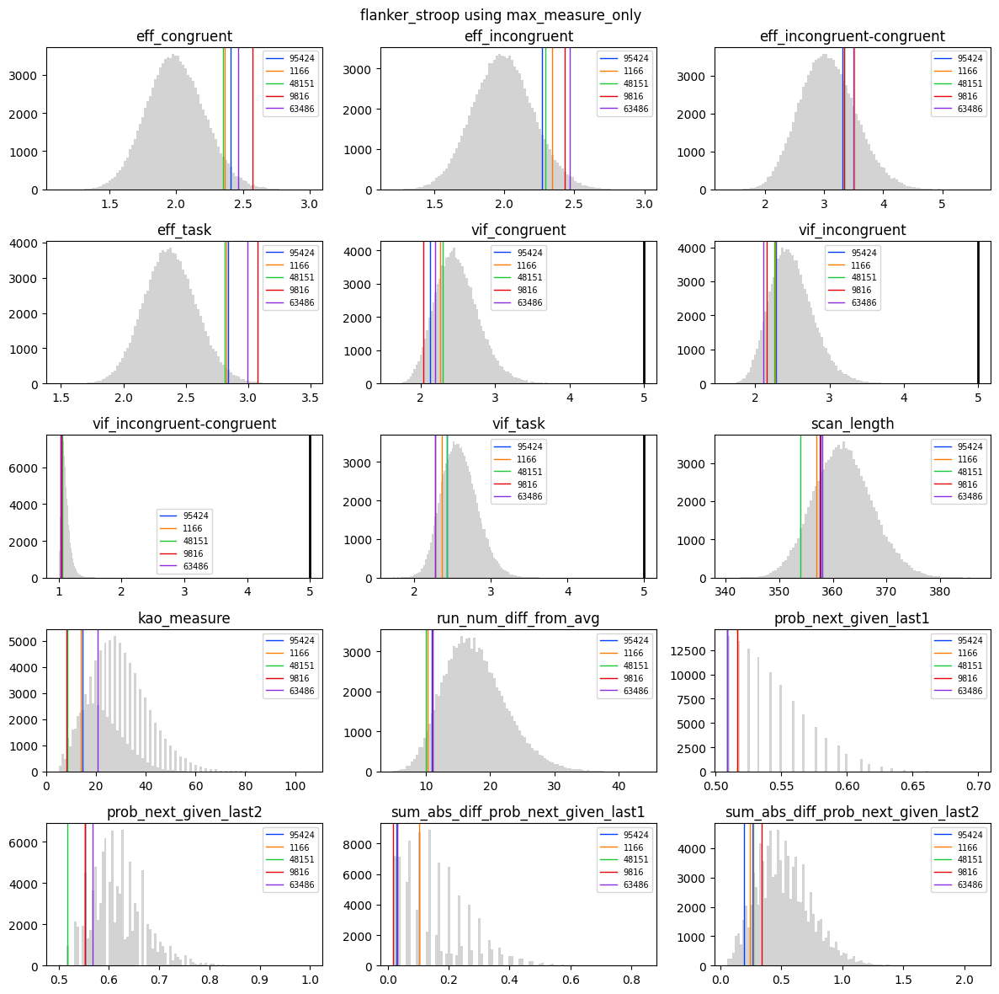

{95424, 1166, 48151, 9816, 63486}


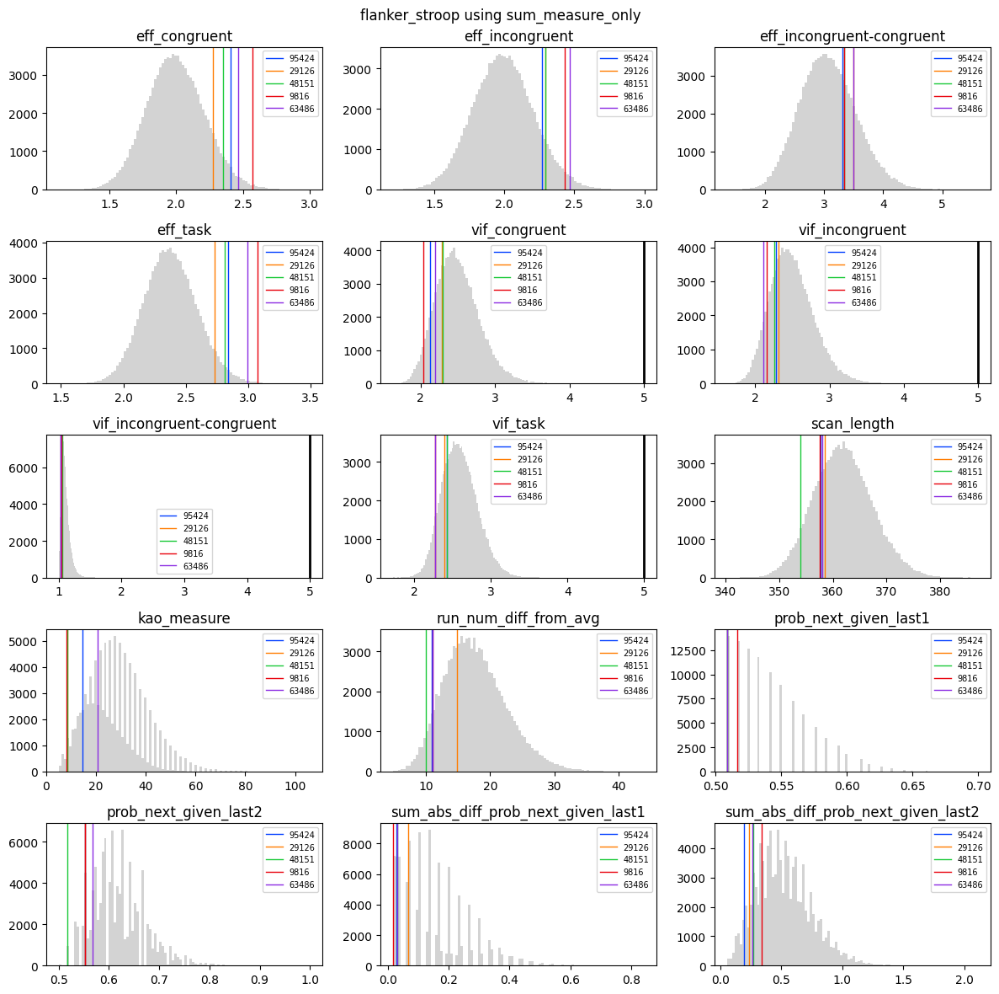

{95424, 29126, 48151, 9816, 63486}


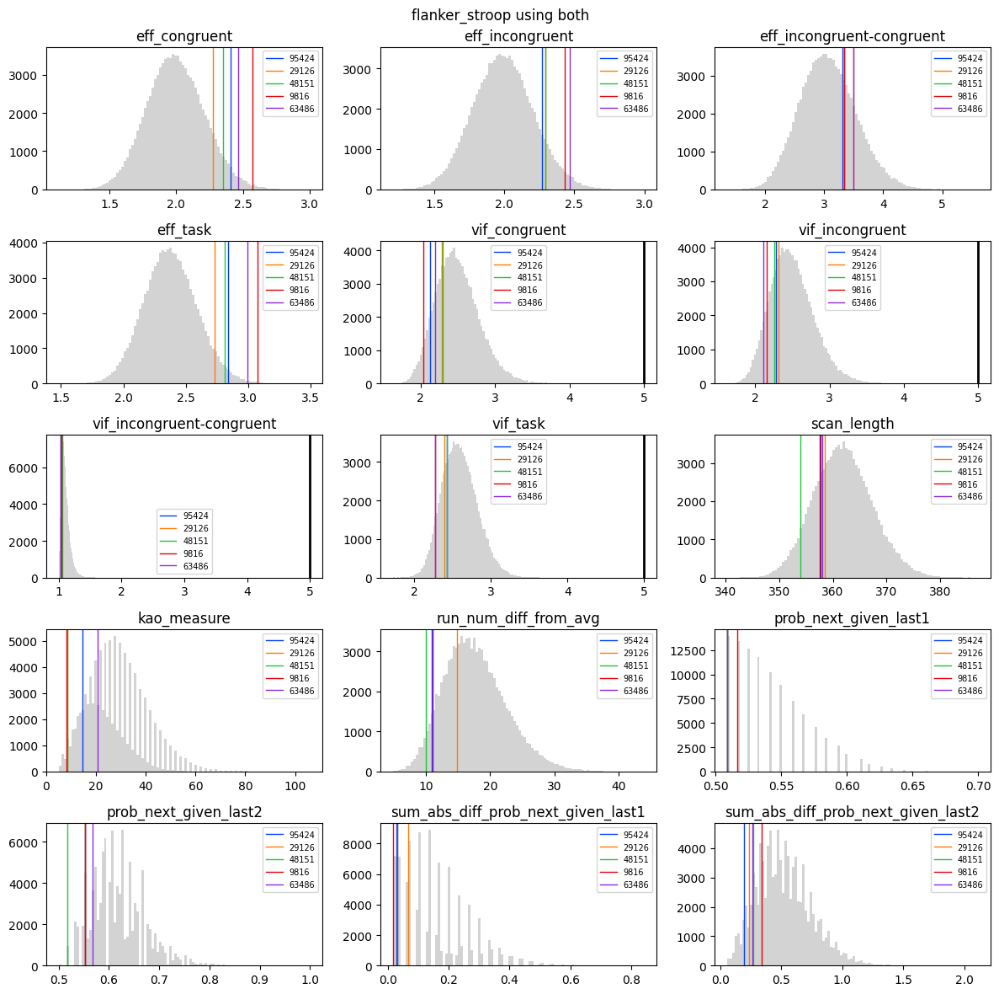

{95424, 29126, 48151, 9816, 63486}


In [8]:
task = 'flanker_stroop'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_flanker_stroop = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_flanker_stroop[choice] = choose_designs(output_flanker_stroop, ranks_flanker_stroop, choice, 5, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_flanker_stroop[choice] = choose_designs(output_flanker_stroop, ranks_flanker_stroop, choice, 5, task, base_psych_meas, make_grid_plot=False)

In [9]:
save_chosen_events_files('flanker_stroop', output_flanker_stroop, events_flanker_stroop, list(overlaps_flanker_stroop['max_measure_only']), root)

## GoNoGo

In [10]:
events_gng, output_gng, ranks_gng = get_events_eff_data(outdir, 'gng')

In [11]:
print(output_gng.shape)

(100000, 16)


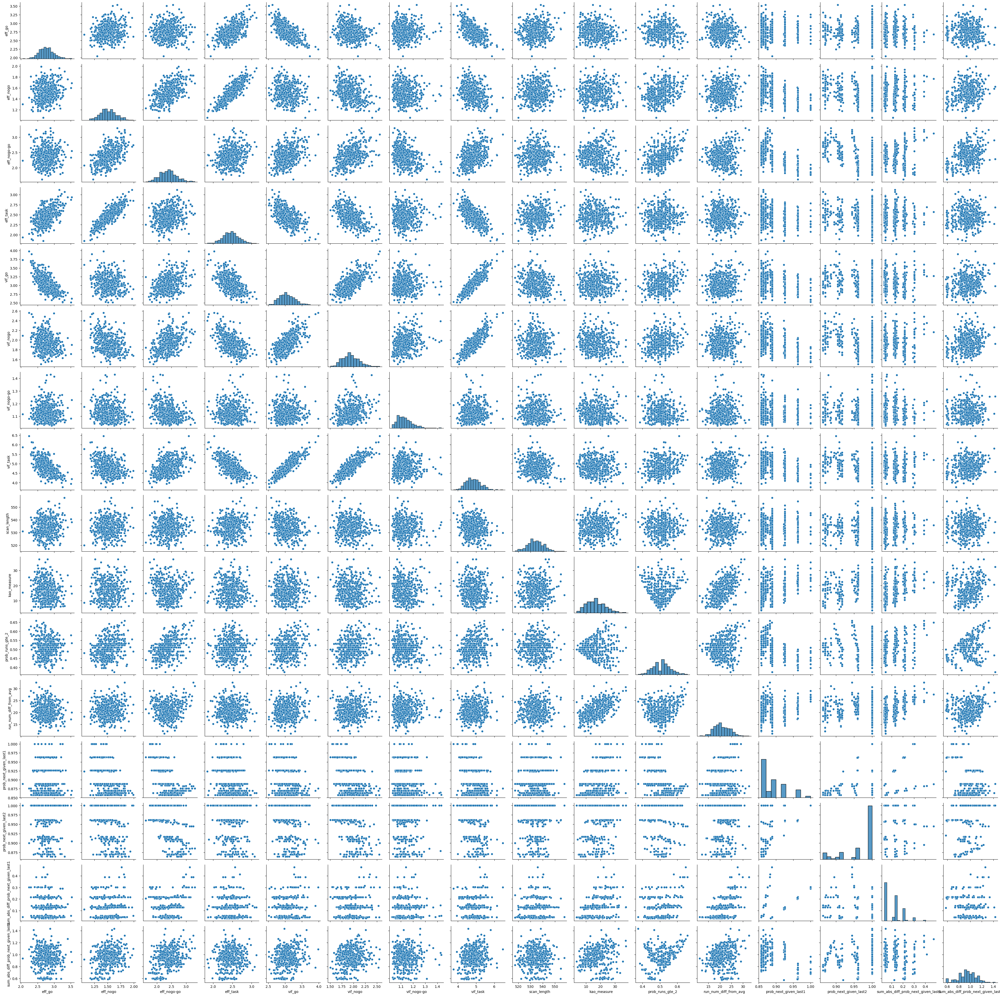

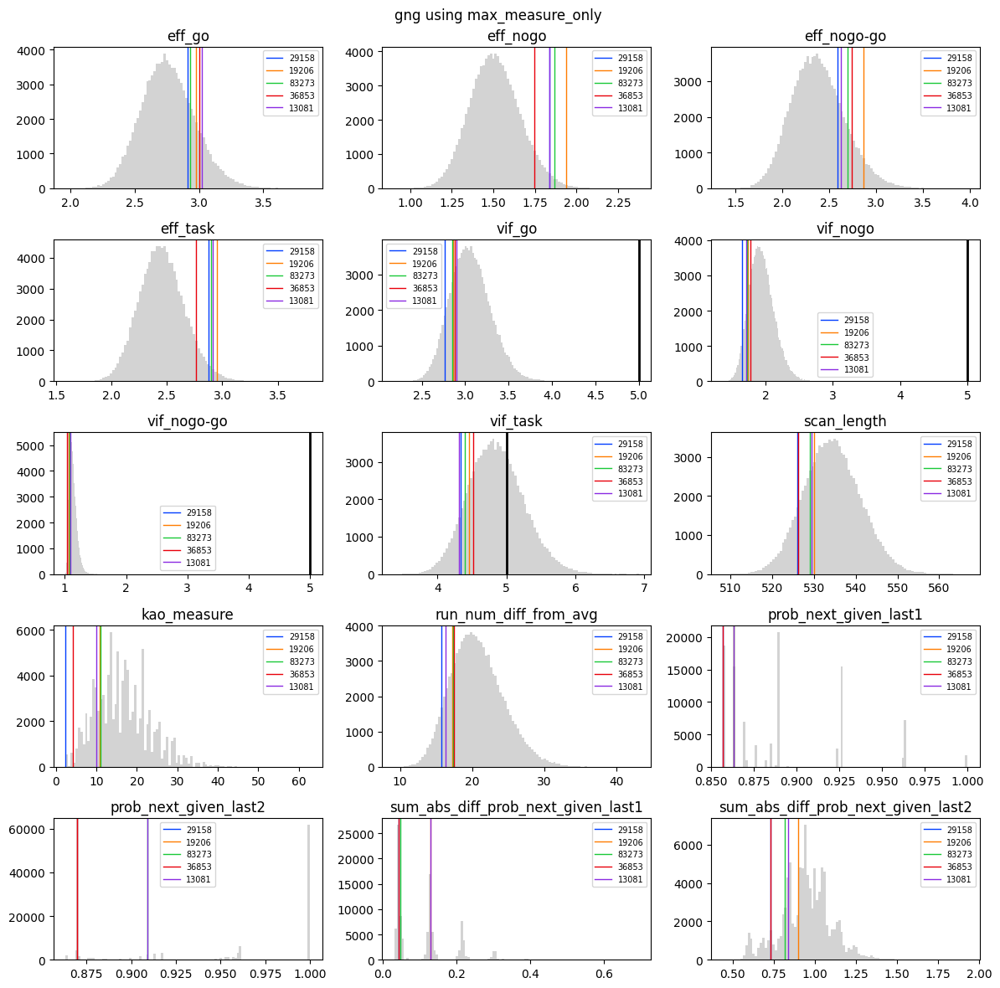

{29158, 19206, 83273, 36853, 13081}


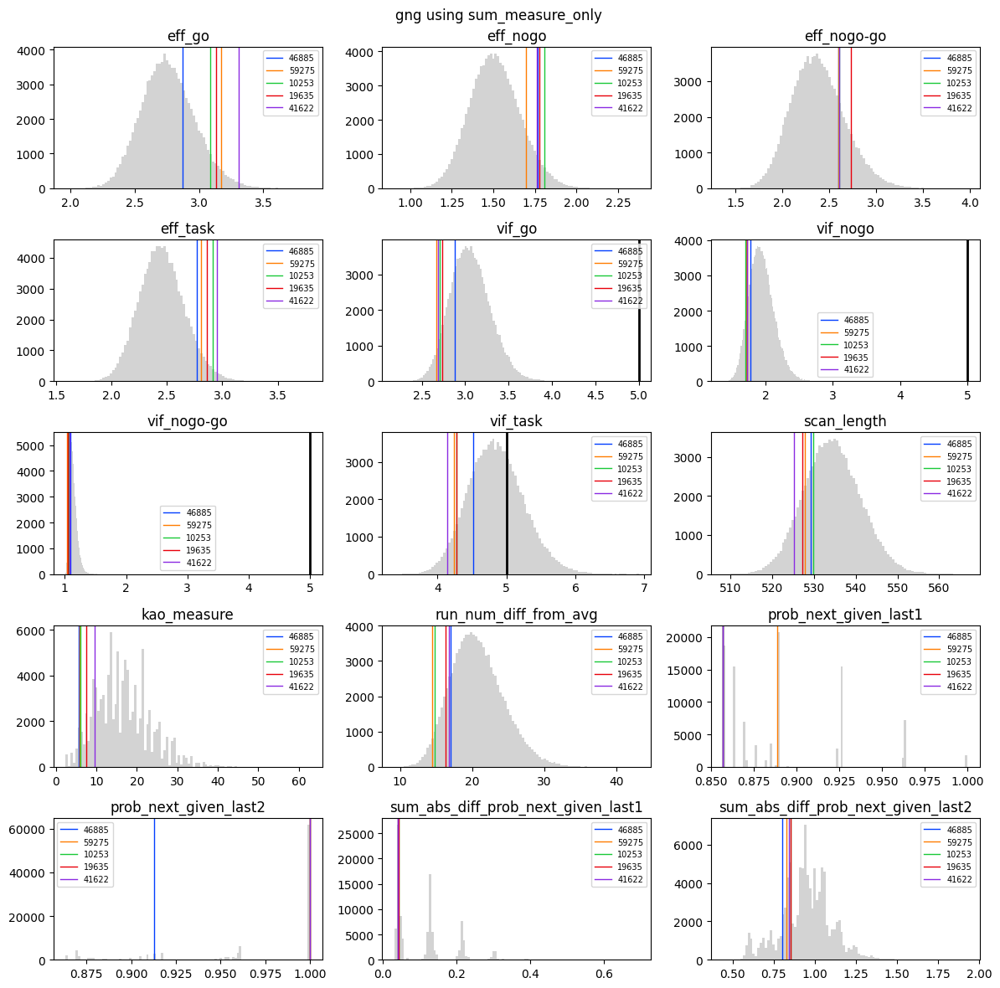

{46885, 59275, 10253, 19635, 41622}


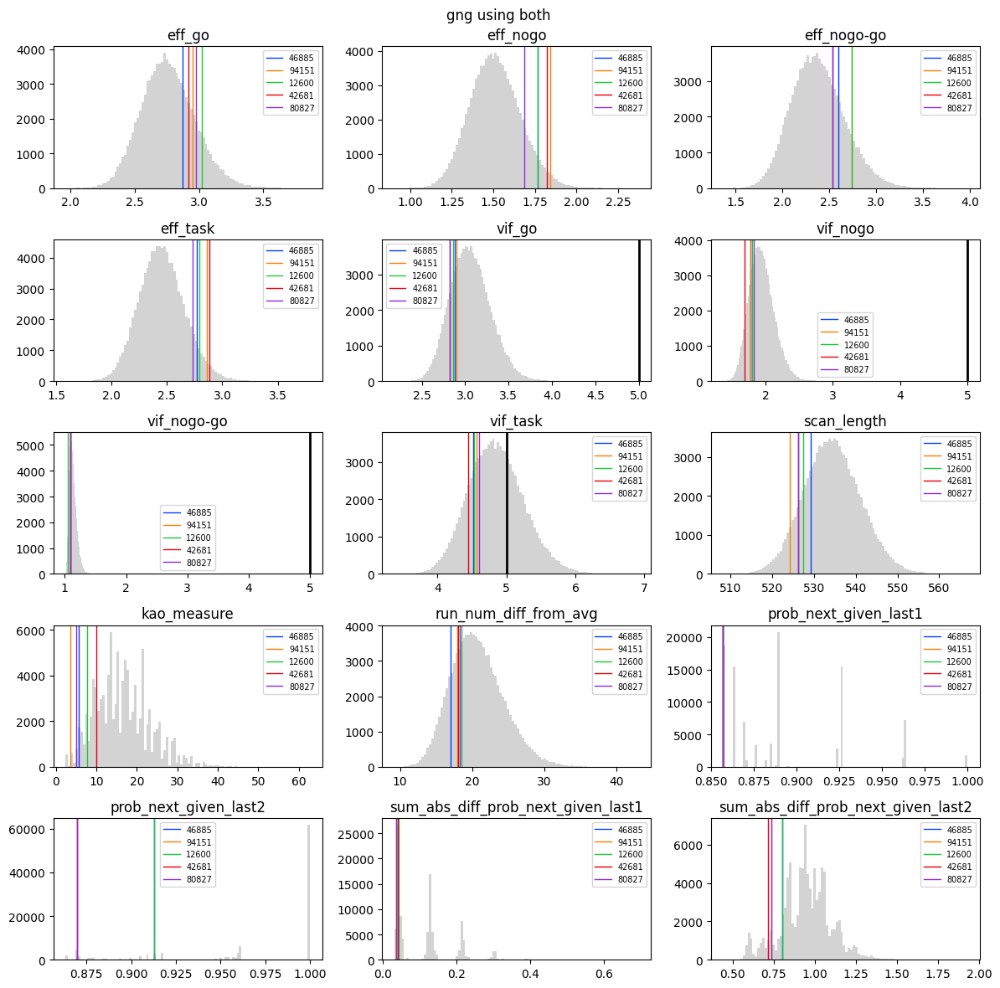

{46885, 94151, 12600, 42681, 80827}


In [12]:
task = 'gng'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_gng = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_gng[choice] = choose_designs(output_gng, ranks_gng, choice, 5, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_gng[choice] = choose_designs(output_gng, ranks_gng, choice, 5, task, base_psych_meas, make_grid_plot=False)


In [13]:

save_chosen_events_files('gng', output_gng, events_gng, list(overlaps_gng['max_measure_only']), root)

## Stop signal

In [14]:
events_stop_signal, output_stop_signal, ranks_stop_signal = get_events_eff_data(outdir, 'stop_signal')

In [15]:
print(output_stop_signal.shape)

(100000, 16)


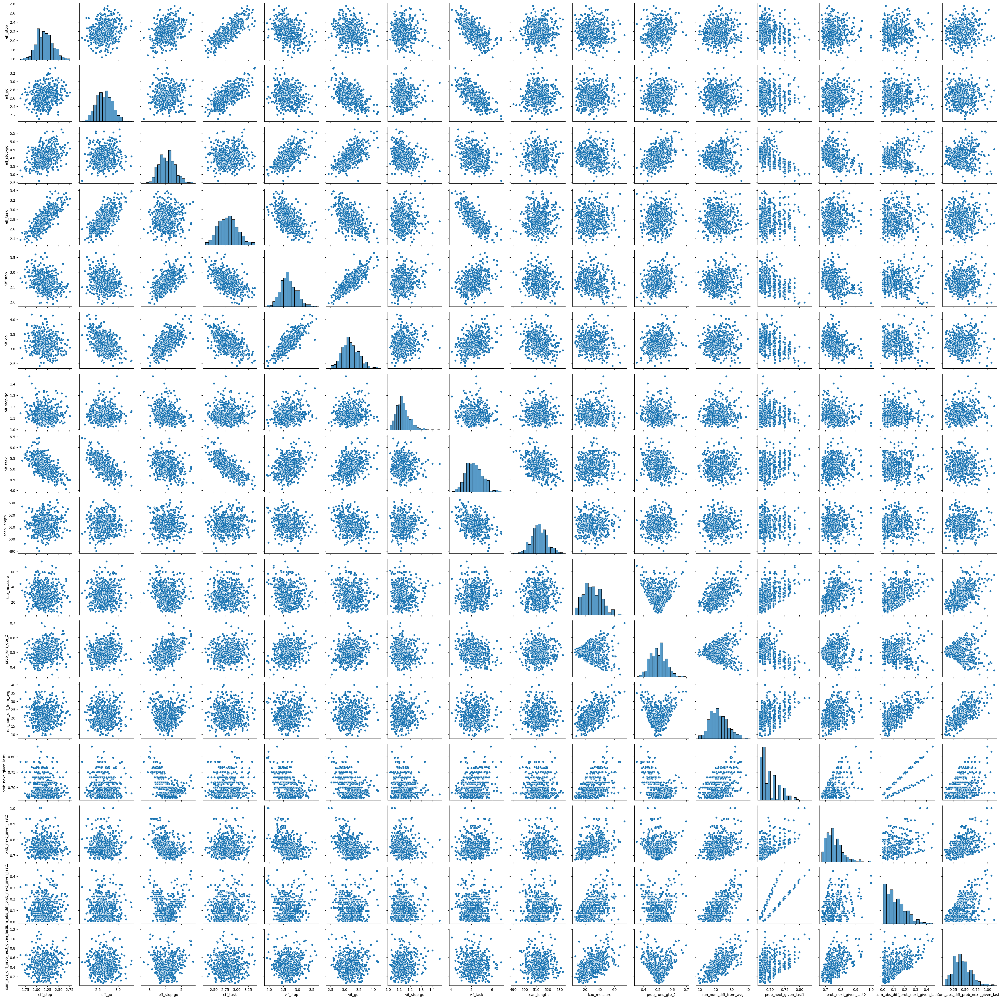

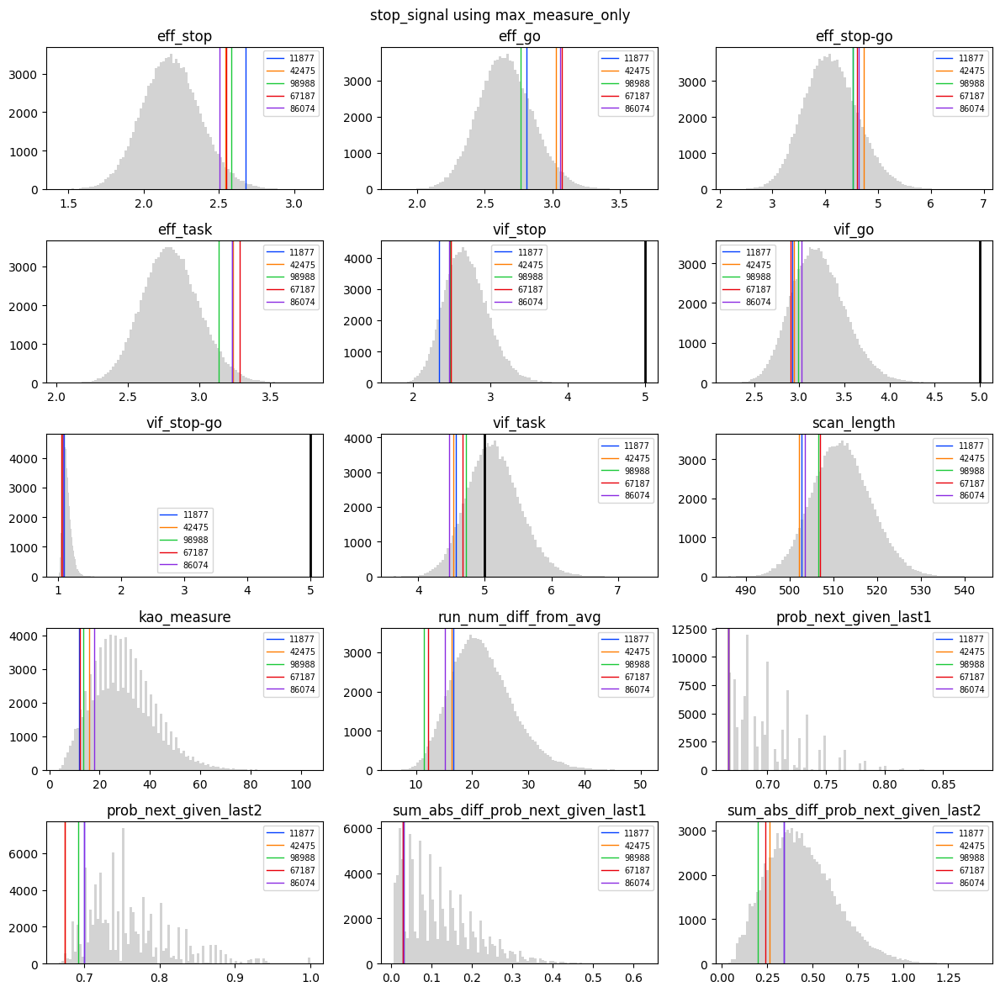

{11877, 42475, 98988, 67187, 86074}


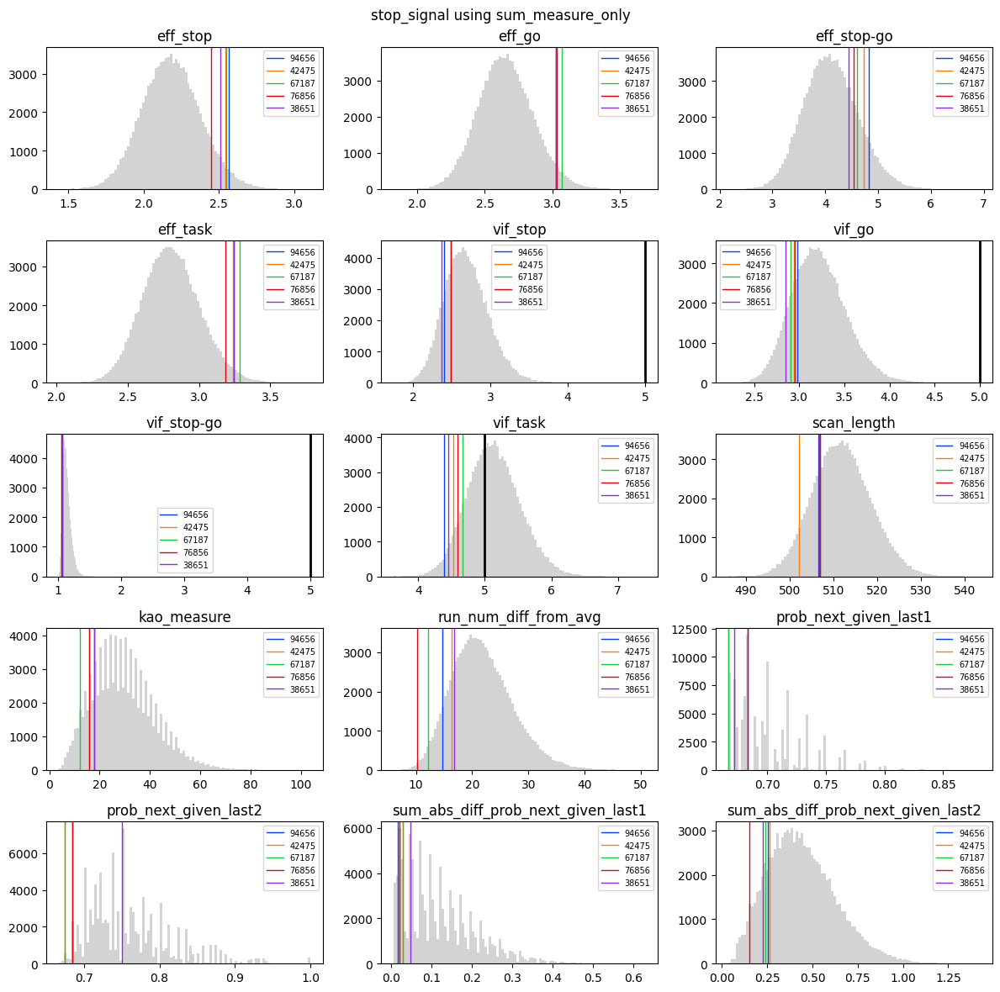

{94656, 42475, 67187, 76856, 38651}


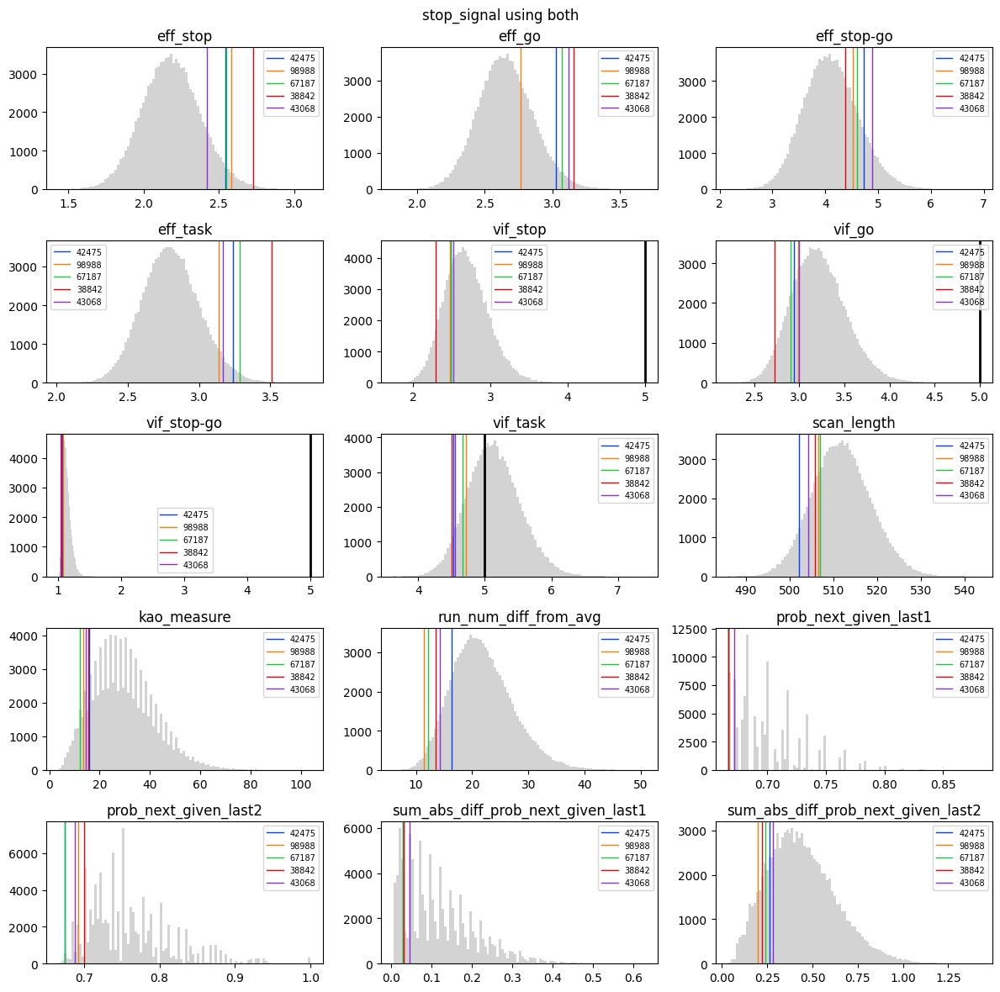

{42475, 98988, 67187, 38842, 43068}


In [16]:
task = 'stop_signal'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_stop_signal = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_stop_signal[choice] = choose_designs(output_stop_signal, ranks_stop_signal, choice, 5, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_stop_signal[choice] = choose_designs(output_stop_signal, ranks_stop_signal, choice, 5, task, base_psych_meas, make_grid_plot=False)

In [17]:
save_chosen_events_files('stop_signal', output_stop_signal, events_stop_signal, list(overlaps_stop_signal['max_measure_only']), root)

## AX CPT

In [18]:
events_ax_cpt, output_ax_cpt, ranks_ax_cpt = get_events_eff_data(outdir, 'ax_cpt')

In [19]:
print(output_ax_cpt.shape)

(100000, 20)


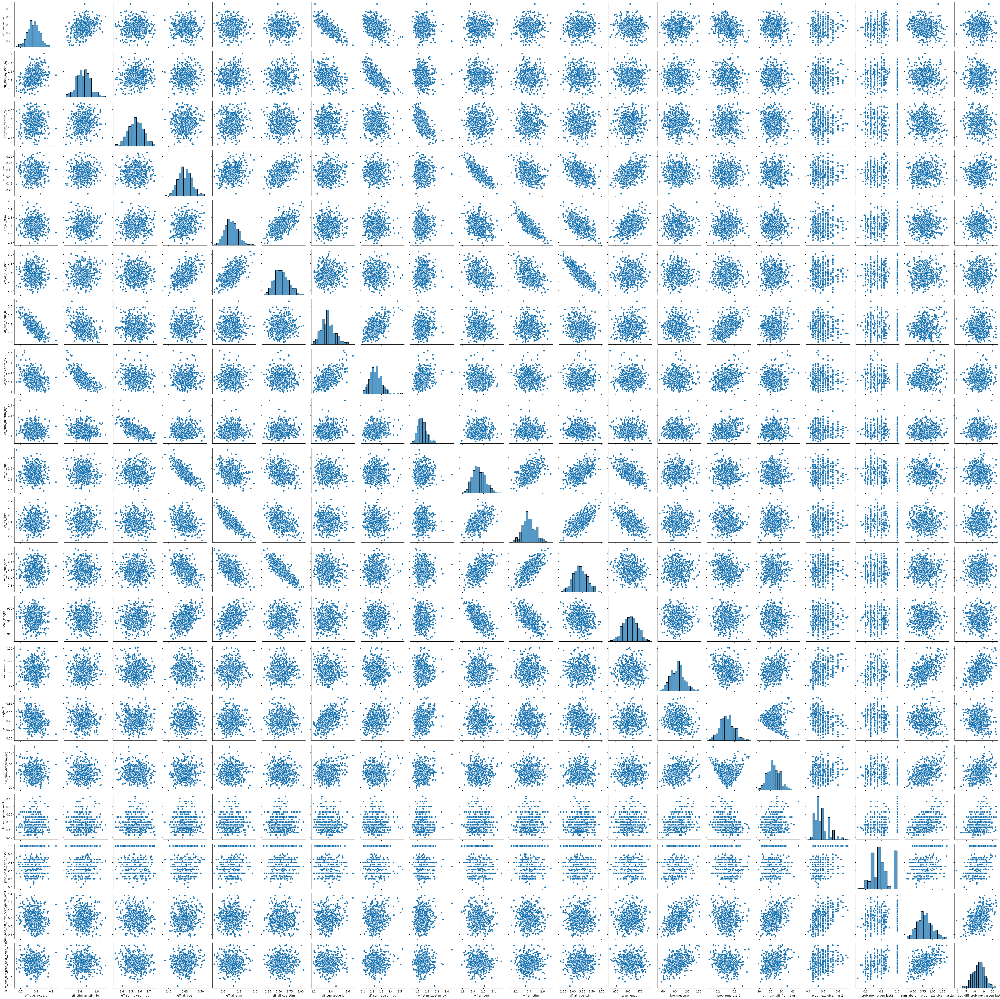

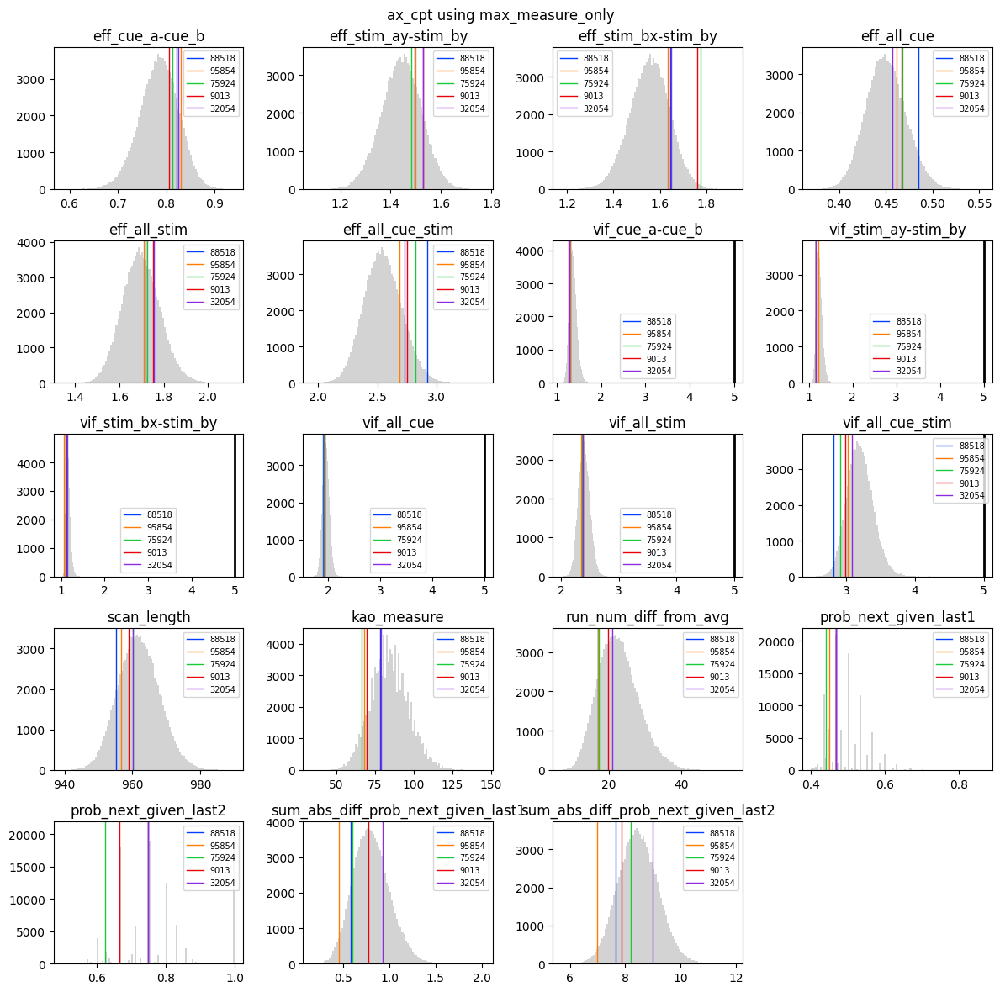

{88518, 95854, 75924, 9013, 32054}


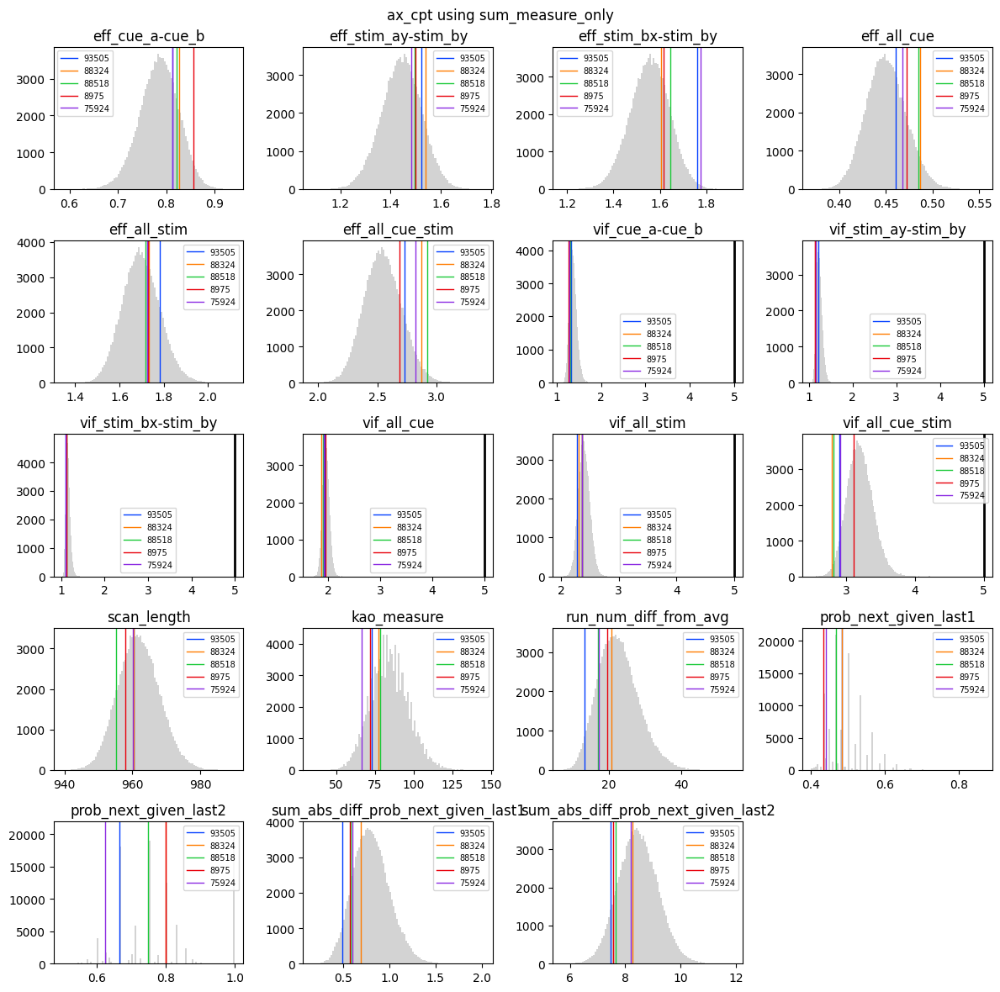

{93505, 88324, 88518, 8975, 75924}


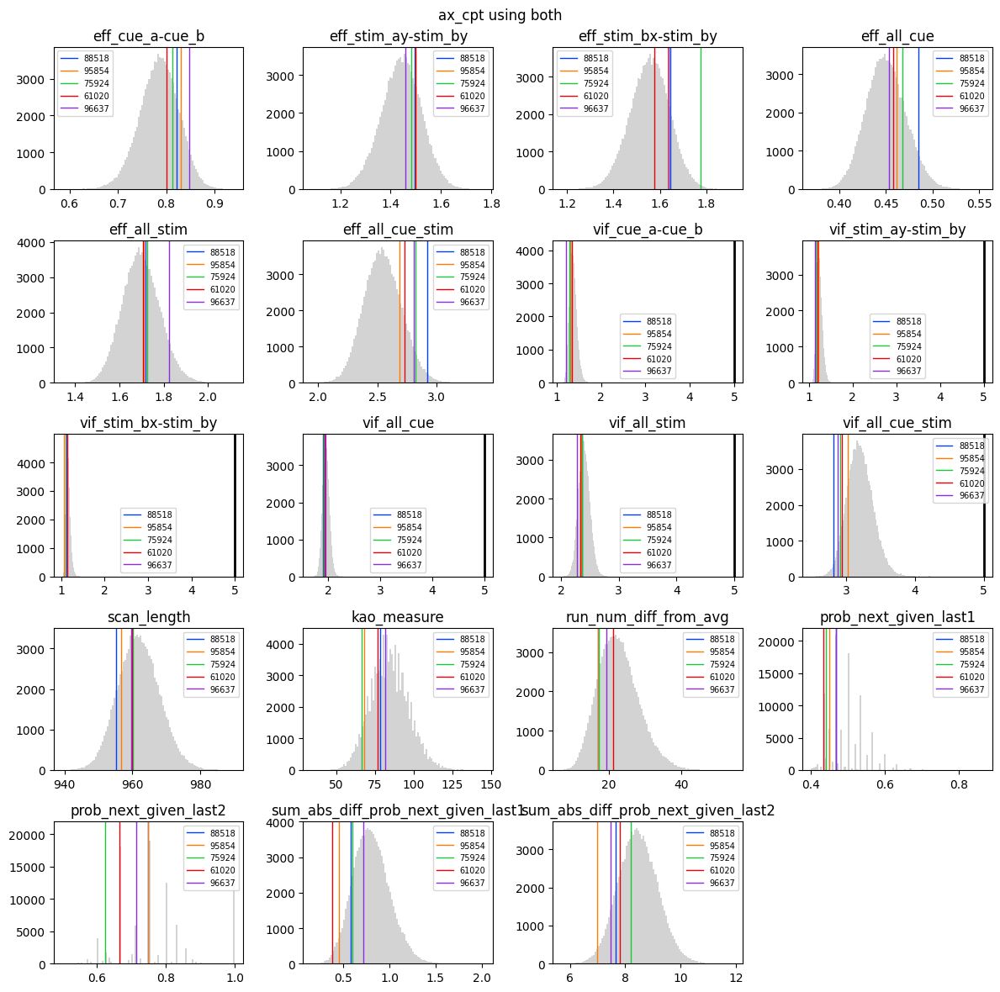

{88518, 95854, 75924, 61020, 96637}


In [20]:
task = 'ax_cpt'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_ax_cpt = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_ax_cpt[choice] = choose_designs(output_ax_cpt, ranks_ax_cpt, choice, 5, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_ax_cpt[choice] = choose_designs(output_ax_cpt, ranks_ax_cpt, choice, 5, task, base_psych_meas, make_grid_plot=False)

In [21]:
save_chosen_events_files('ax_cpt', output_ax_cpt, events_ax_cpt, list(overlaps_ax_cpt['max_measure_only']), root)

## Cued TS and Spatial TS

In [22]:
events_cued_ts_spatial_ts, output_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts = get_events_eff_data(outdir, 'cued_ts_spatial_ts')

In [23]:
print(output_cued_ts_spatial_ts.shape)

(100000, 14)


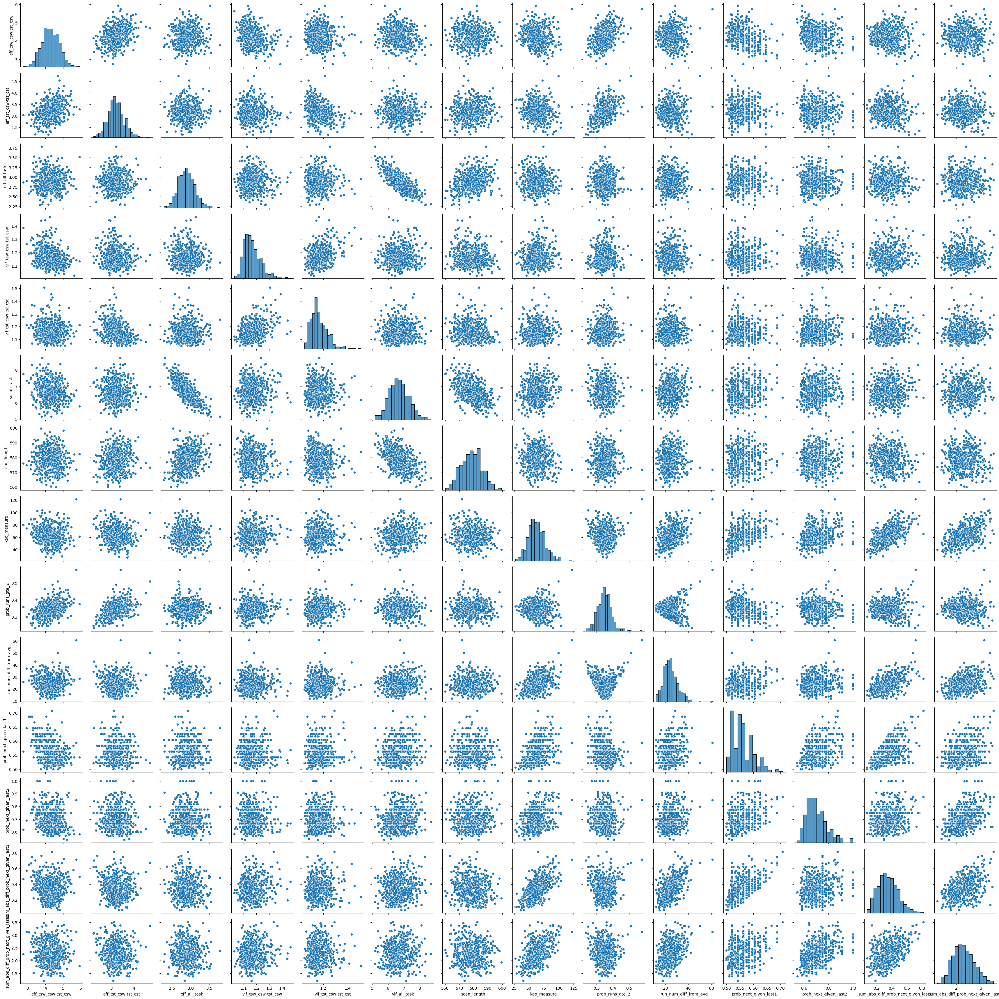

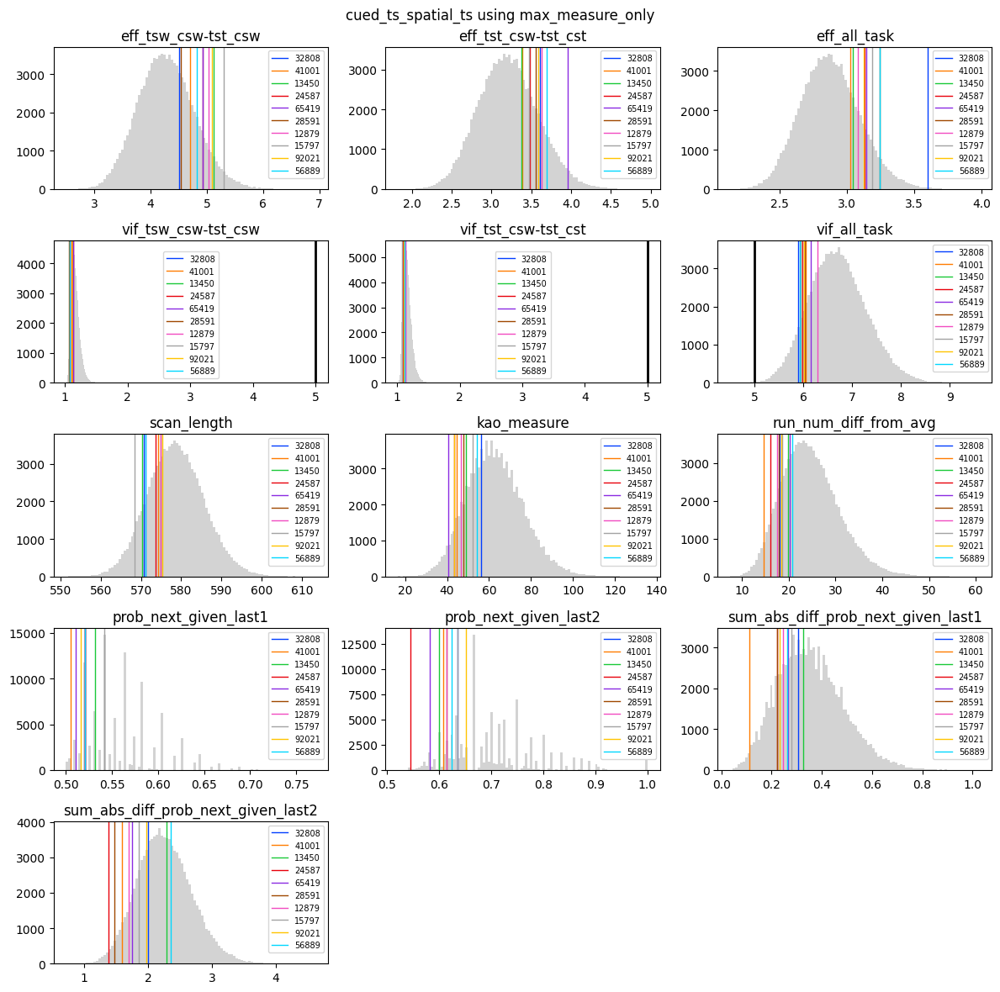

{32808, 41001, 13450, 24587, 65419, 28591, 12879, 15797, 92021, 56889}


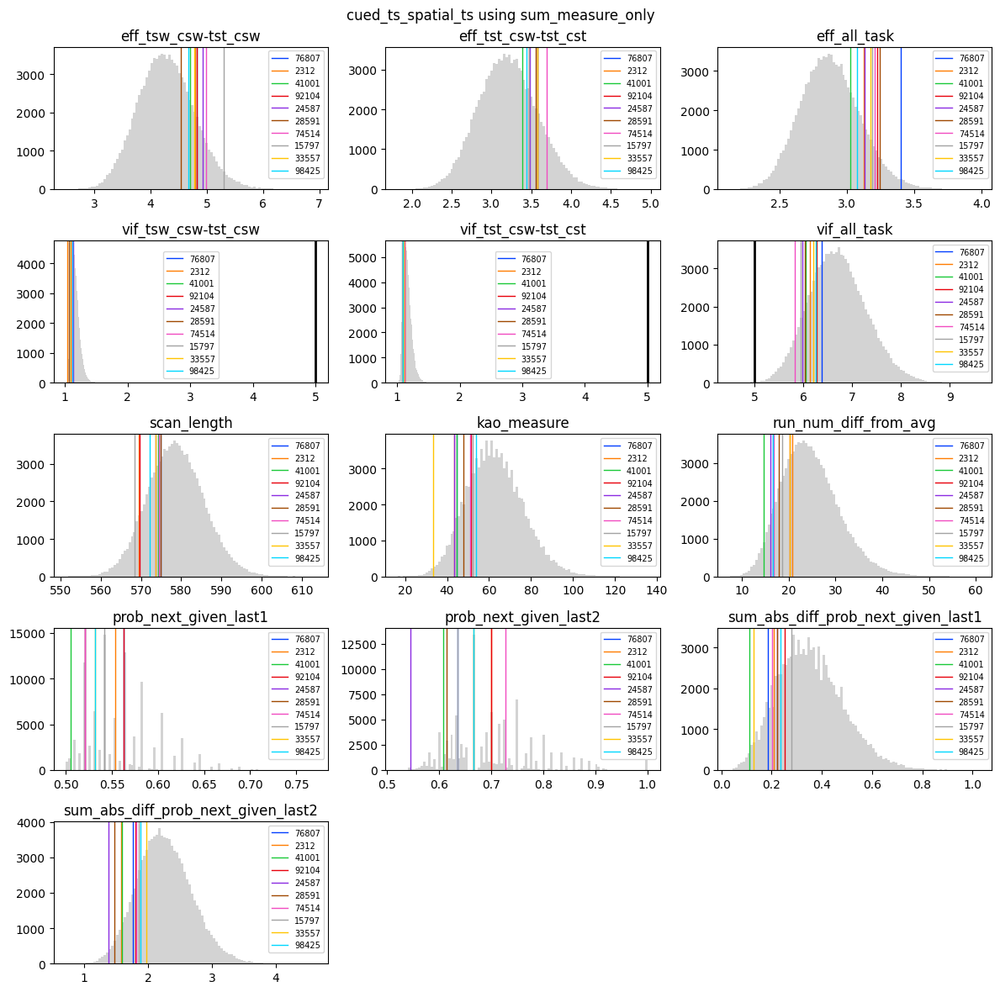

{76807, 2312, 41001, 92104, 24587, 28591, 74514, 15797, 33557, 98425}


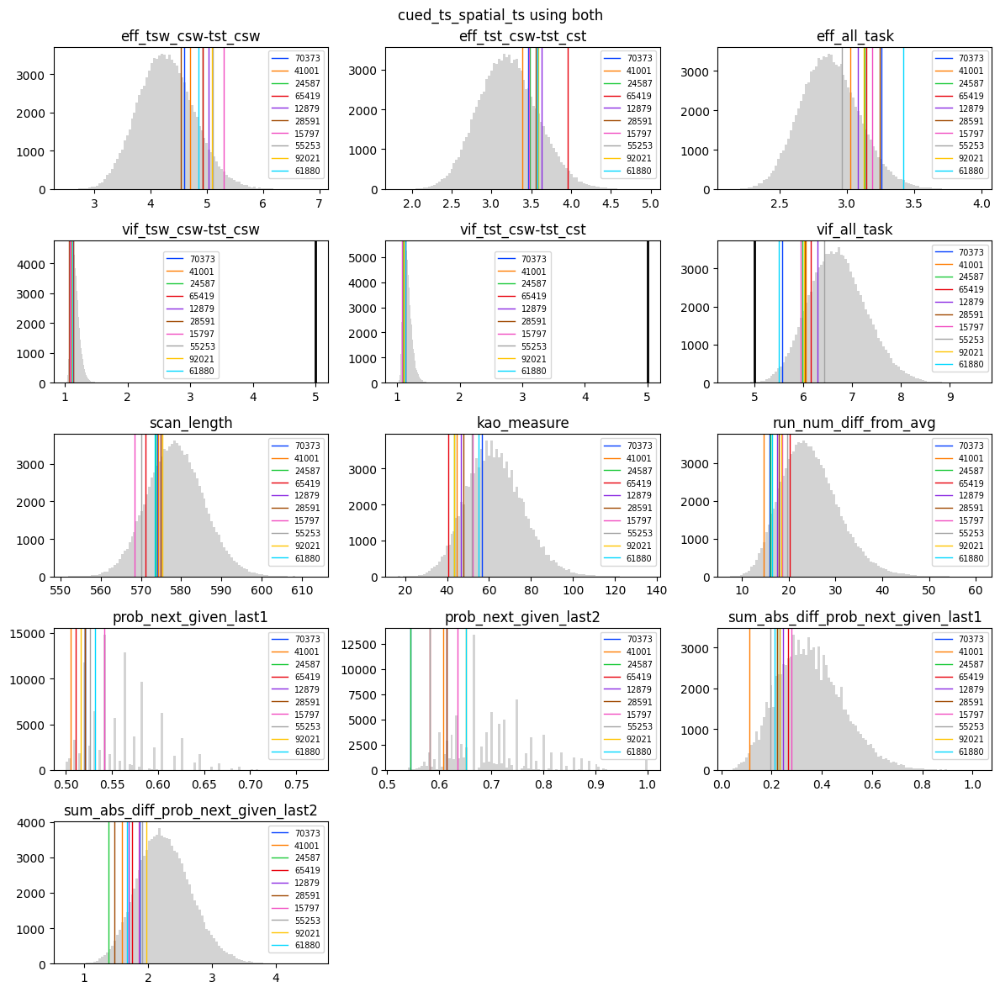

{70373, 41001, 24587, 65419, 12879, 28591, 15797, 55253, 92021, 61880}


In [24]:
task = 'cued_ts_spatial_ts'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_cued_ts_spatial_ts = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_cued_ts_spatial_ts[choice] = choose_designs(output_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts, choice, 10, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_cued_ts_spatial_ts[choice] = choose_designs(output_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts, choice, 10, task, base_psych_meas, make_grid_plot=False)

In [25]:
save_chosen_events_files('cued_ts_spatial_ts', output_cued_ts_spatial_ts, events_cued_ts_spatial_ts, 
                         list(overlaps_cued_ts_spatial_ts['max_measure_only']), root)

## Nback

In [26]:
events_nback, output_nback, ranks_nback = get_events_eff_data(outdir, 'nback')
print(output_nback.shape)

(100000, 16)


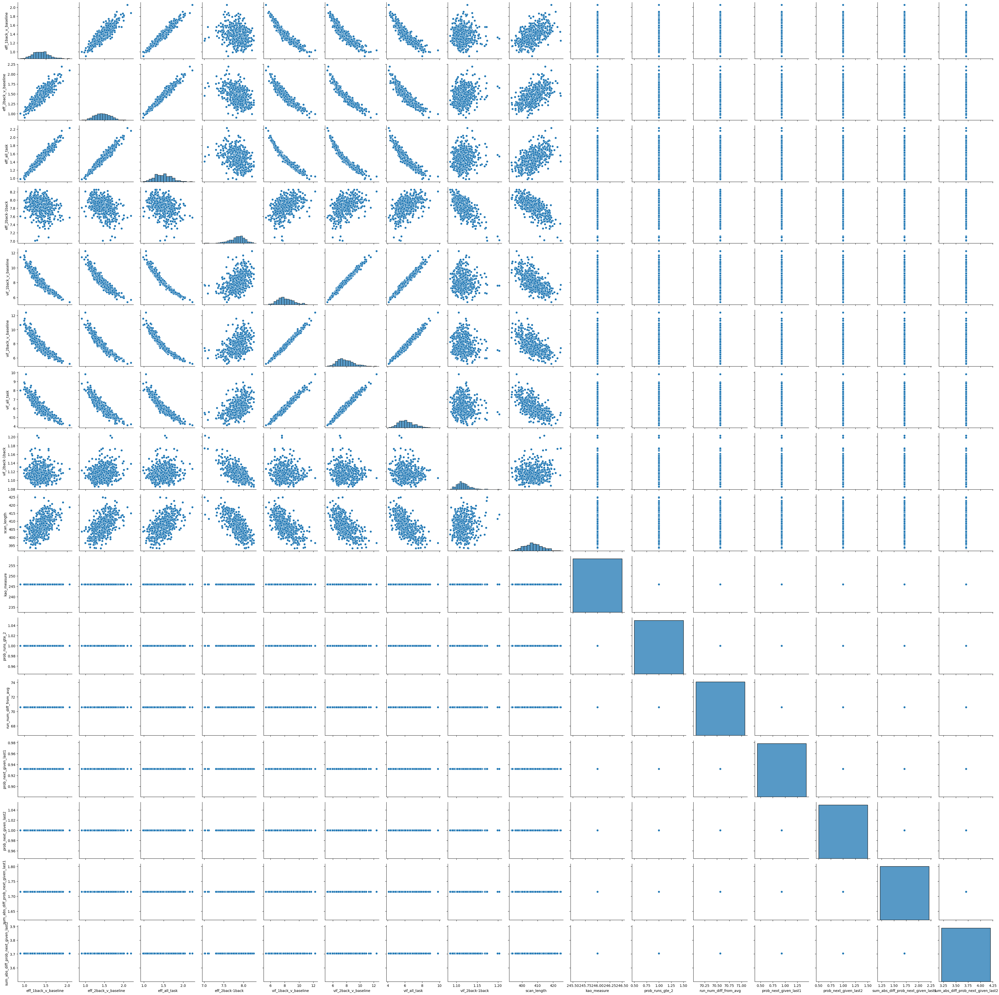

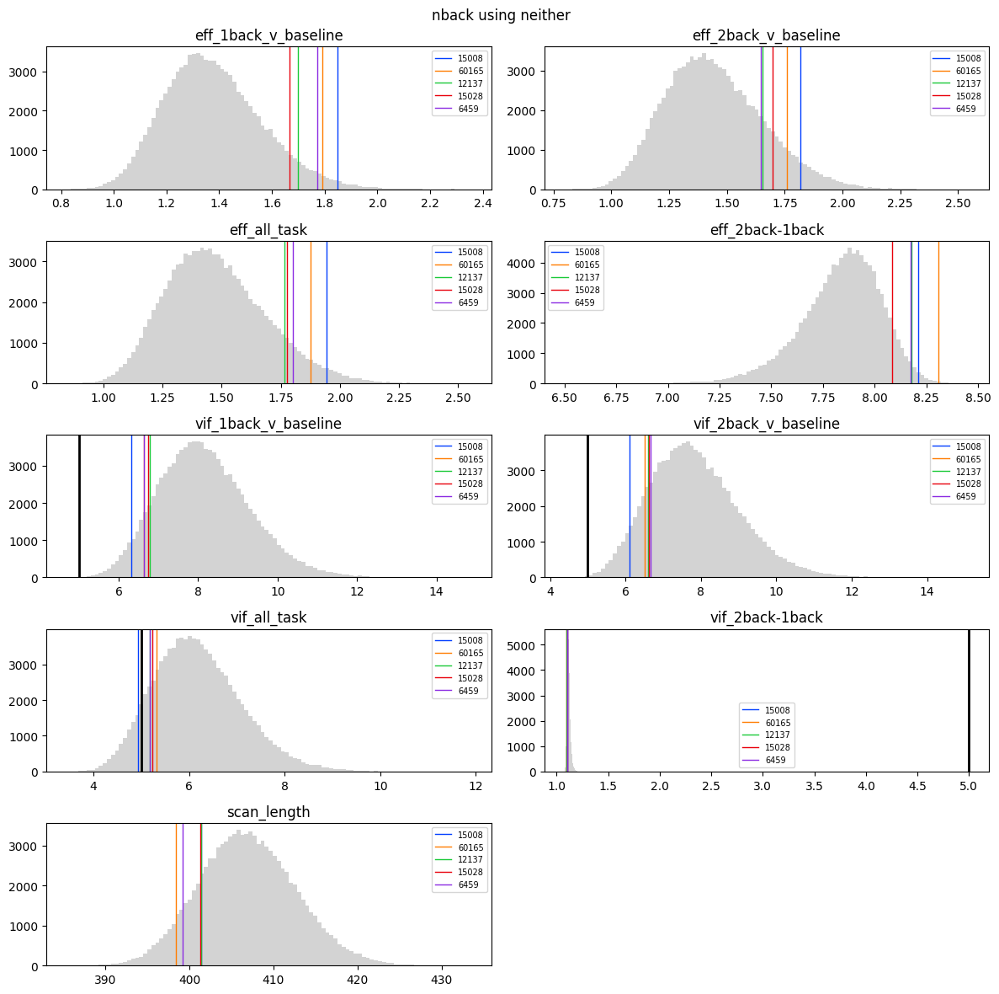

{15008, 60165, 12137, 15028, 6459}


In [27]:
task = 'nback'
base_psych_meas = ['scan_length']
choice = 'neither'
overlaps_nback = {}

overlaps_nback[choice] = choose_designs(output_nback, ranks_nback, choice, 5, task, base_psych_meas, make_grid_plot=True)


In [28]:
save_chosen_events_files('nback', output_nback, events_nback, list(overlaps_nback['neither']), root)

## Span


In [29]:
events_span, output_span, ranks_span = get_events_eff_data(outdir, 'span')

In [30]:
print(output_span.shape)

(100000, 5)


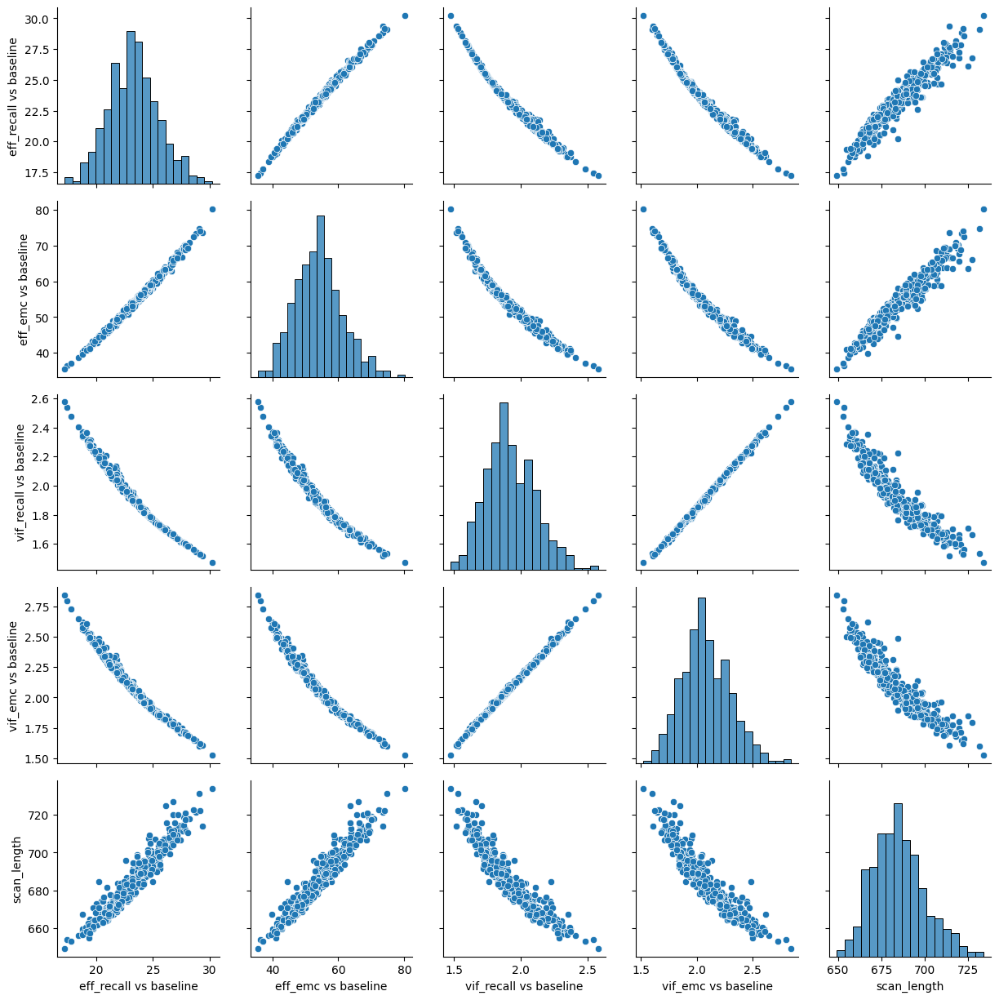

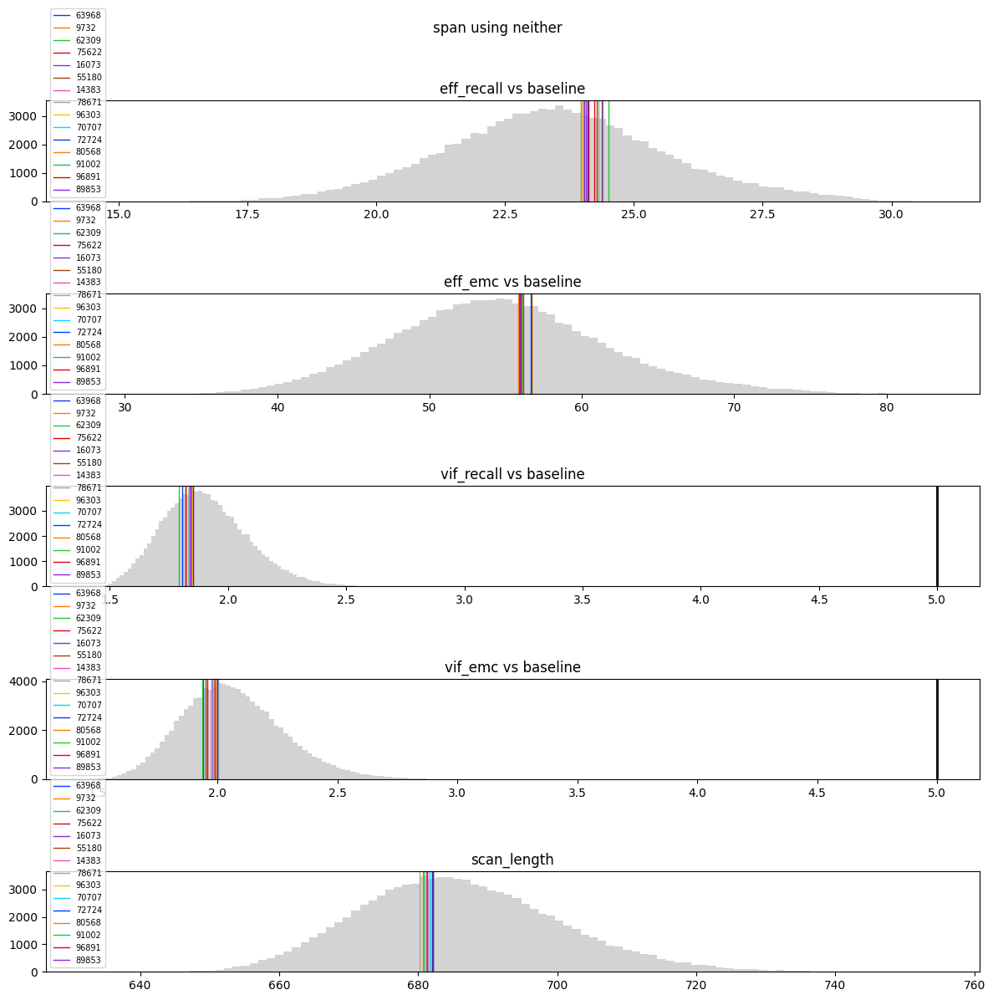

{63968, 9732, 62309, 75622, 16073, 55180, 14383, 78671, 96303, 70707, 72724, 80568, 91002, 96891, 89853}


In [31]:
task = 'span'
base_psych_meas = ['scan_length']
choice = 'neither'
overlaps_span = {}

overlaps_span[choice] = choose_designs(output_span, ranks_span, choice, 15, task, base_psych_meas, make_grid_plot=True)


In [32]:
save_chosen_events_files('span', output_span, events_span, list(overlaps_span['neither']), root)

## Spatial Cueing

In [33]:
events_spatial_cueing, output_spatial_cueing, ranks_spatial_cueing = get_events_eff_data(outdir, 'spatial_cueing')
print(output_spatial_cueing.shape)

(100000, 14)


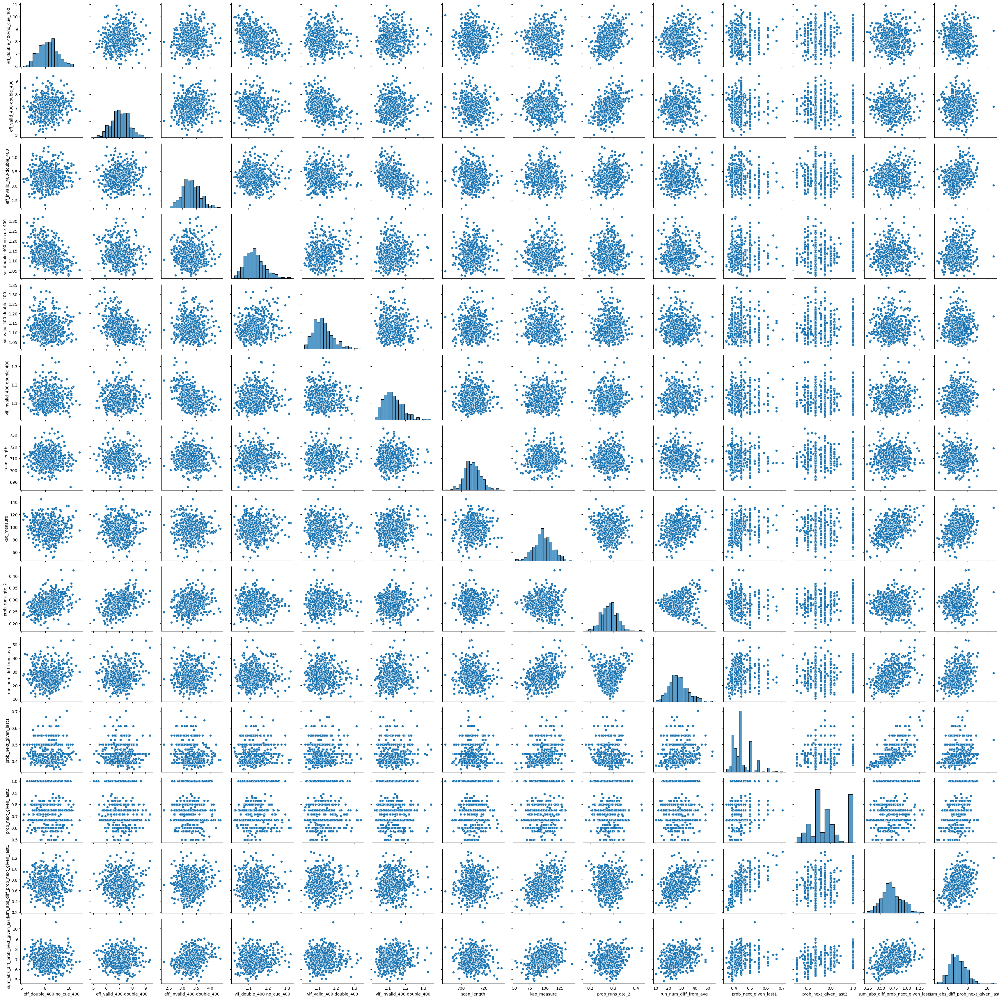

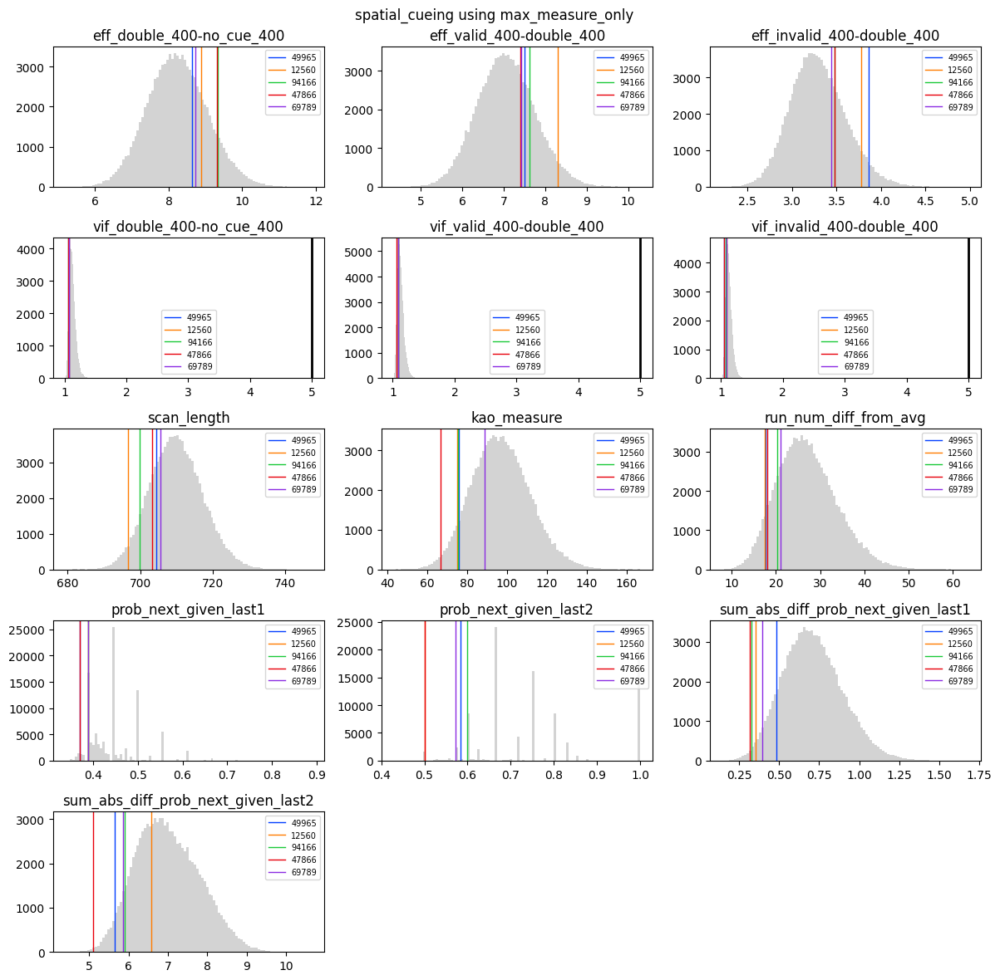

{49965, 12560, 94166, 47866, 69789}


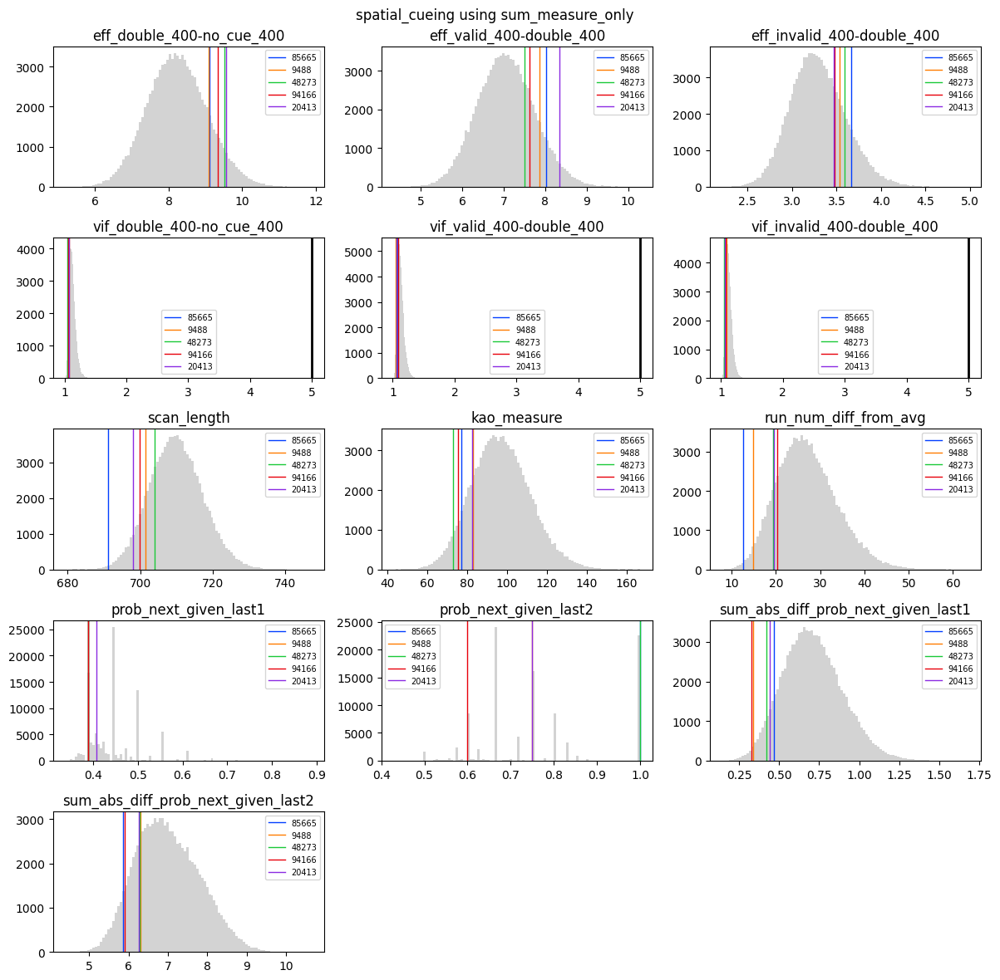

{85665, 9488, 48273, 94166, 20413}


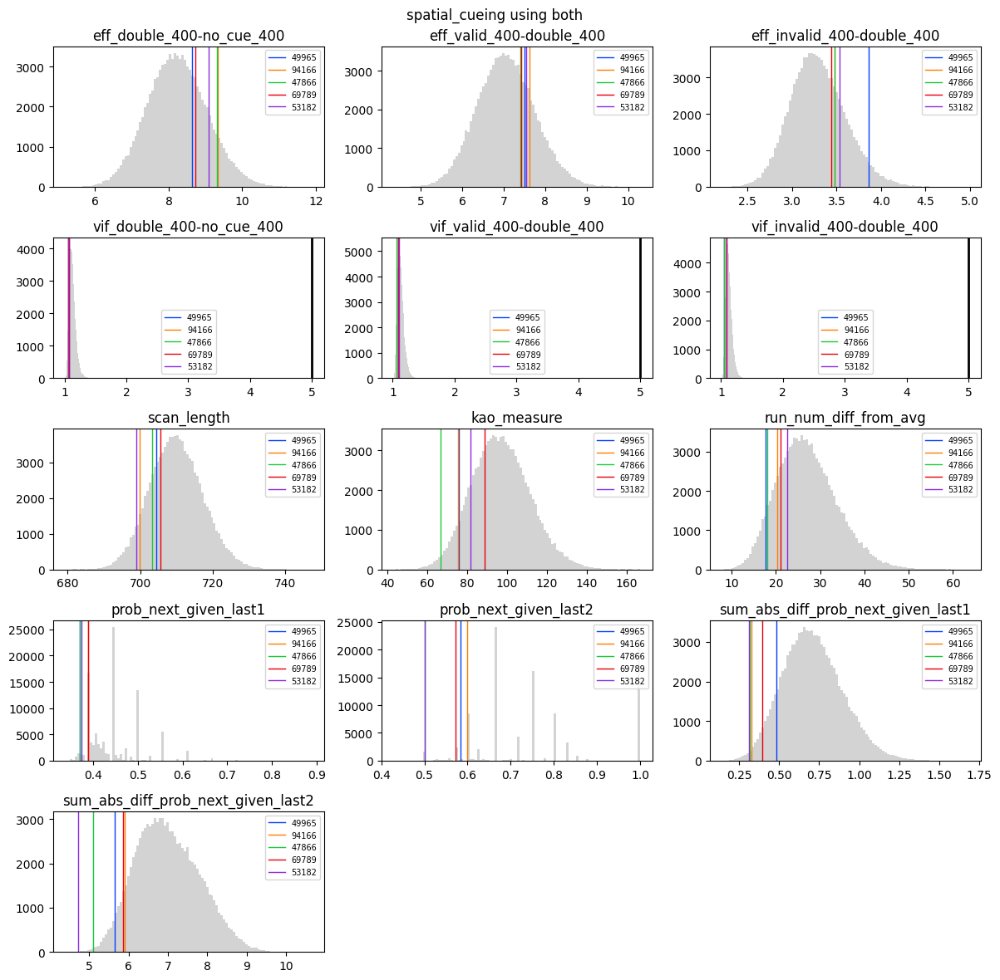

{49965, 94166, 47866, 69789, 53182}


In [34]:
task = 'spatial_cueing'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_spatial_cueing = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_spatial_cueing[choice] = choose_designs(output_spatial_cueing, ranks_spatial_cueing, choice, 5, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_spatial_cueing[choice] = choose_designs(output_spatial_cueing, ranks_spatial_cueing, choice, 5, task, base_psych_meas, make_grid_plot=False)

In [35]:
save_chosen_events_files('spatial_cueing', output_spatial_cueing, events_spatial_cueing, list(overlaps_spatial_cueing['max_measure_only']), root)

## Visual Search

In [36]:
events_visual_search, output_visual_search, ranks_visual_search = get_events_eff_data(outdir, 'visual_search')
print(output_visual_search.shape)

(100000, 14)


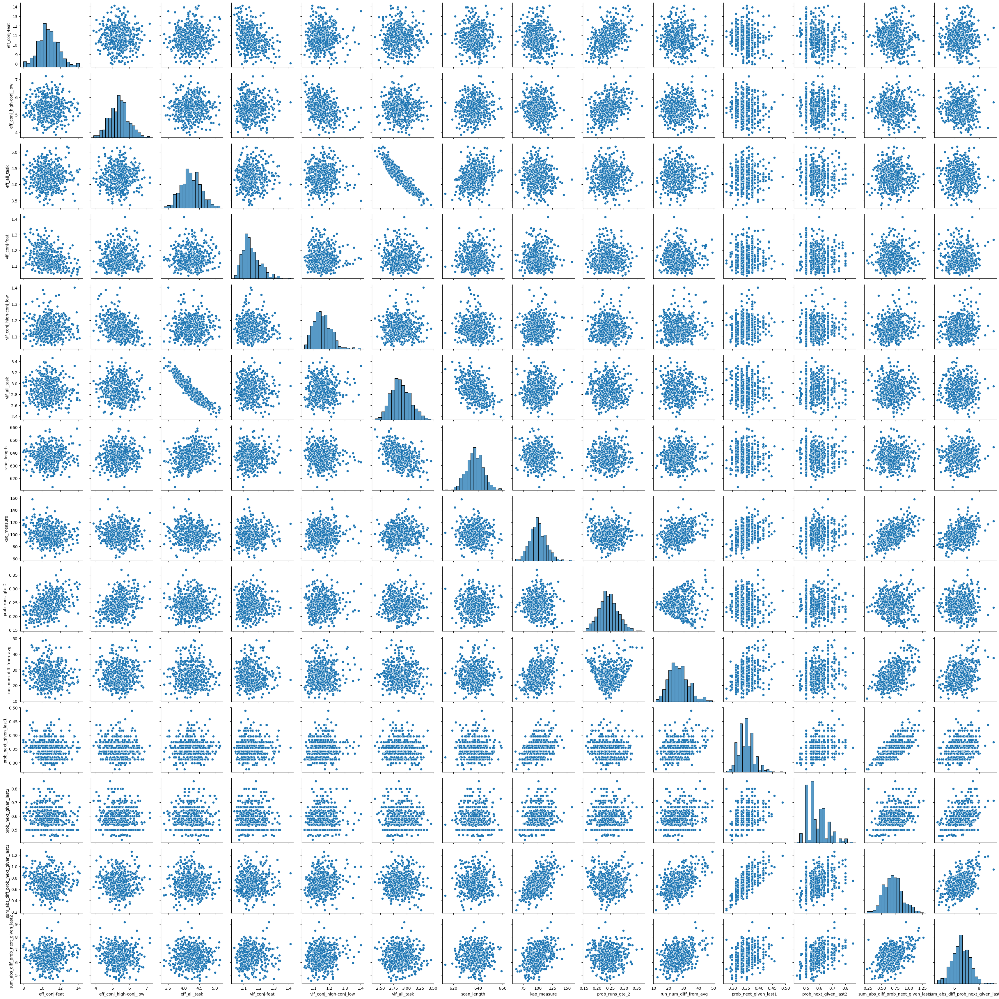

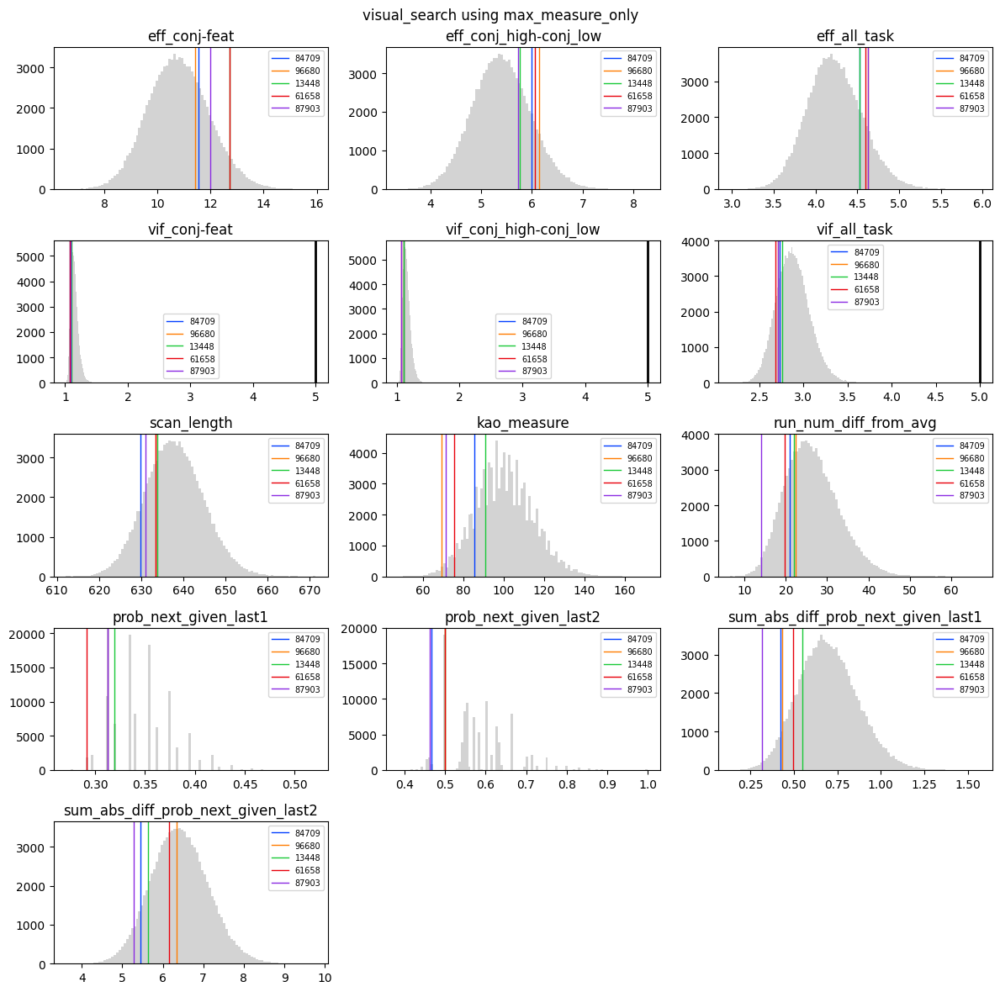

{84709, 96680, 13448, 61658, 87903}


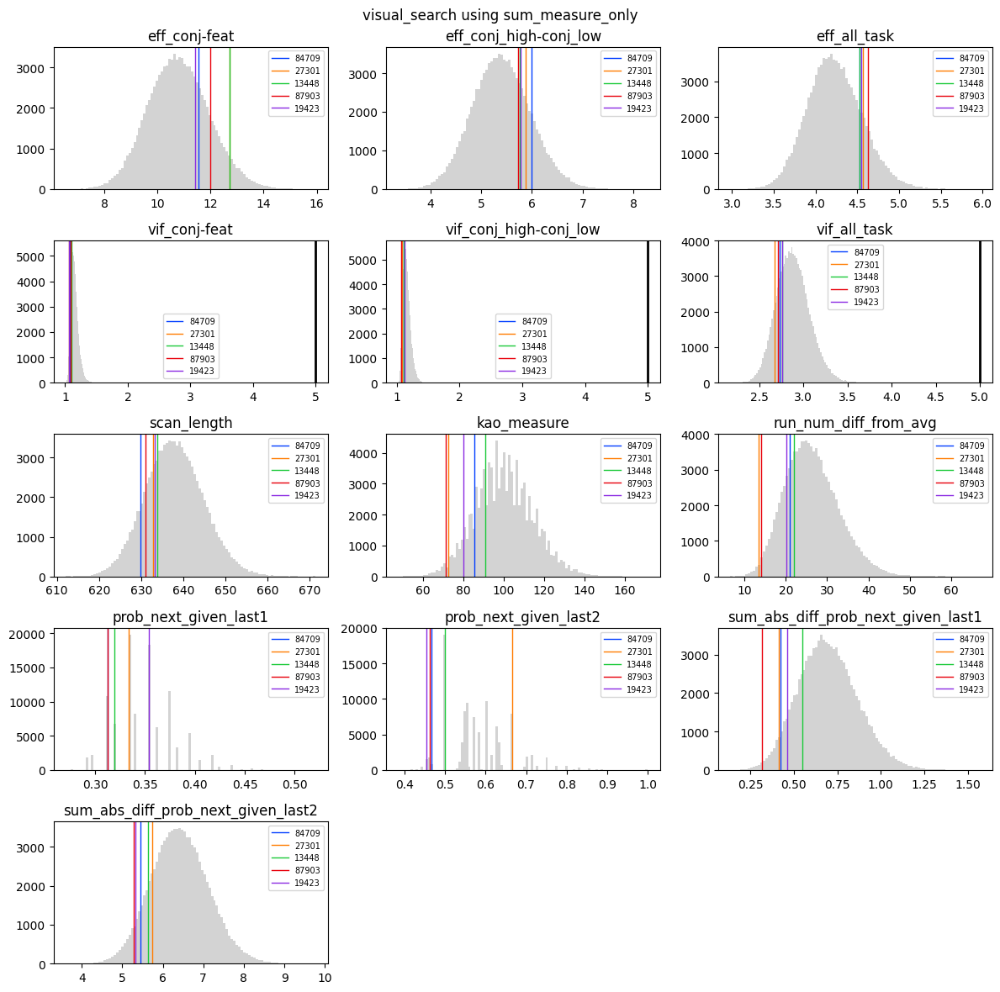

{84709, 27301, 13448, 87903, 19423}


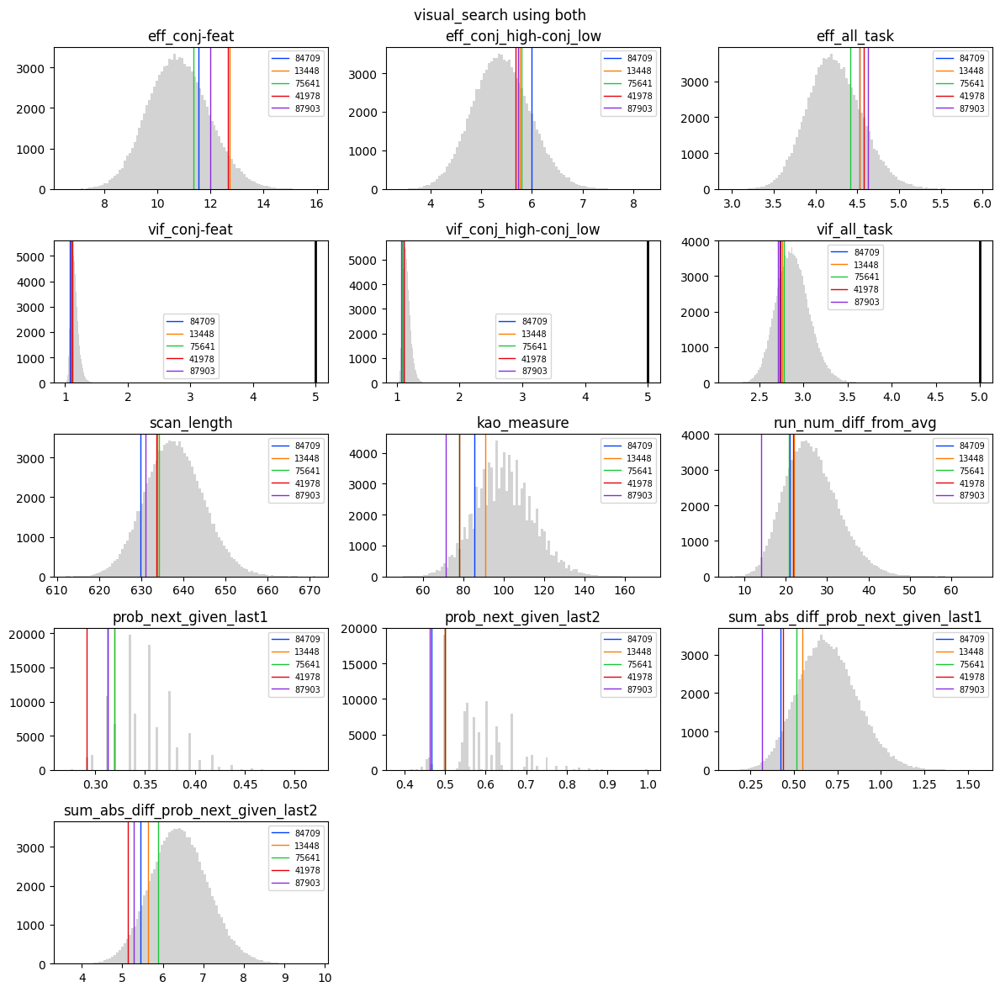

{84709, 13448, 75641, 41978, 87903}


In [37]:
task = 'visual_search'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_visual_search = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_visual_search[choice] = choose_designs(output_visual_search, ranks_visual_search, choice, 5, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_visual_search[choice] = choose_designs(output_visual_search, ranks_visual_search, choice, 5, task, base_psych_meas, make_grid_plot=False)

In [38]:
save_chosen_events_files('visual_search', output_visual_search, events_visual_search, list(overlaps_visual_search['max_measure_only']), root)